![Logo ADL](https://github.com/fcastellanosp/MINE-4210_202420_ADL/blob/main/Laboratorios/logo_adl.png?raw=true)

# **Proyecto Deep Learning**


## Proyecto de Identificación de Especies con Cámaras Trampa

En este proyecto, se utilizó un modelo de detección de objetos entrenado para identificar y clasificar especies animales capturadas por cámaras trampa en la región de la Orinoquía. El conjunto de datos incluye imágenes etiquetadas que pertenecen a las siguientes clases de animales:

- **Armadillo**
- **Black Agouti**
- **Collared Peccary**
- **White-lipped Peccary**
- **Crypturellus**
- **Giant Anteater**
- **White-tailed Deer**
- **Lowland Tapir**
- **Margarita Island Capuchin**
- **Ocelot**
- **Rodent**
- **Salvins Curassow**
- **South American Coati**
- **Southern Tamandua**
- **Spixs Guan**
- **Spotted Paca**
- **Squirrel**
- **Tayra**

La conservación de especies es fundamental para mantener el equilibrio de los ecosistemas y garantizar la sostenibilidad del planeta. Cada especie, por pequeña que sea, cumple un rol crucial en la red de la vida, contribuyendo a procesos ecológicos como la polinización, el control de plagas y el reciclaje de nutrientes. La pérdida de biodiversidad no solo afecta a la naturaleza, sino también a las comunidades humanas que dependen de ella para su alimentación, salud y economía. En un contexto de cambios climáticos y actividades humanas crecientes, proteger a las especies en peligro de extinción no es solo un imperativo ético, sino también una estrategia clave para preservar el futuro de la vida en la Tierra.

# 0. Configuración Inicial

Después de inspeccionar el conjunto de datos "[Bangladesh traffic](https://www.kaggle.com/datasets/hasibzunair/rsud20k-bangladesh-road-scene-understanding)" podemos observar que ya se encuentran en el formato esperado por la modelo pre-entrenado Yolo:

```python
dataset/
  images/
    train/
      a_image_1.jpg
      a_image_2.jpg  
    val/
      a_image_3.jpg
      a_image_4.jpg
    test/
      a_image_5.jpg
      a_image_6.jpg        
  labels/        
    train/
      a_image_1.txt
      a_image_2.txt  
    val/
      a_image_3.txt
      a_image_4.txt
    test/
      a_image_5.txt
      a_image_6.txt        
```

Por lo tanto instalaremos todos el paquete necesario para su uso.

### 0.1 Instalación de Paquetes

In [4]:
pip install cv2

Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement cv2 (from versions: none)
ERROR: No matching distribution found for cv2


In [5]:
pip install ultralytics optuna


Note: you may need to restart the kernel to use updated packages.


In [6]:
!pip install ultralytics==8.2.98
!pip install keras-tuner

from IPython import display
display.clear_output()

Como podemos ver, se ha instalado la versión 8 de Yolo

### 0.1 Importación de Paquetes

In [13]:
#Numpy y Pandas
import pandas as pd
import numpy as np
from numpy import asarray
import os
import random
import cv2

#Librerías de Scikit Learn
import sklearn
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from ultralytics import YOLO

#Librerías de Keras y Tensor Flow
import tensorflow as tf
import keras_tuner as kt

from keras.models import Sequential
from keras.layers import Dropout, Flatten, Dense, Input, Rescaling, Lambda, MaxPooling2D, Conv2D, AveragePooling2D, Activation, Reshape
from keras import backend as K
from keras import applications
from keras.utils import plot_model
from tensorflow.keras.optimizers import Adam

#Gráficos
import matplotlib.pyplot as plt
%matplotlib inline

#Otras Librerías
import os.path as osp
from PIL import Image
import tensorflow as tf
import ultralytics
import shutil
import zipfile


## 0.2 Comprobación de versiones

In [15]:
#Verificamos las versiones de las librerías
print(f"La versión de sklearn es: {sklearn.__version__}")
print('Tensorflow version:', tf.__version__)

La versión de sklearn es: 1.5.1
Tensorflow version: 2.18.0


Debemos asegurarnos que la GPU esté disponible, debido a que el proceso de entrenamiento de este tipo de redes neuronales es bastante exigente para el procesador

In [17]:
# Verificar si TensorFlow está utilizando la GPU
print("¿La GPU está disponible?:", tf.test.is_gpu_available())
print("Nombre de la GPU disponible:", tf.config.experimental.list_physical_devices('GPU'))

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.
¿La GPU está disponible?: False
Nombre de la GPU disponible: []


In [18]:
ultralytics.checks()

Ultralytics YOLOv8.2.98  Python-3.12.7 torch-2.5.1+cpu CPU (Intel Xeon Silver 4310 2.10GHz)
Setup complete  (8 CPUs, 16.0 GB RAM, 53.9/59.3 GB disk)


In [ ]:
import shutil

# Ruta de la carpeta que deseas eliminar
folder_to_delete = "images"

# Eliminar la carpeta y todo su contenido
shutil.rmtree(folder_to_delete)

print(f"La carpeta {folder_to_delete} ha sido eliminada.")


### 0.2 Carga de datos


Este código descomprime un archivo ZIP (camaras_ajustado_final.zip) en la carpeta images, creando el directorio si no existe y manteniendo la estructura original de las carpetas. Utiliza el módulo zipfile para extraer los archivos y confirma la operación con un mensaje al finalizar.

In [350]:
# Ruta del archivo ZIP
images_zip_path = "camaras_ajustado_final.zip"

# Ruta para la carpeta de imágenes extraídas
images_folder = "images"

# Crear la carpeta para las imágenes si no existe
os.makedirs(images_folder, exist_ok=True)

# Descomprimir las imágenes manteniendo la estructura de carpetas
with zipfile.ZipFile(images_zip_path, 'r') as zip_ref:
    zip_ref.extractall(images_folder)

print(f"Imágenes descomprimidas con estructura de carpetas en {images_folder}")


Imágenes descomprimidas con estructura de carpetas en images


In [352]:
# Ruta de la carpeta que deseas eliminar
folder_to_delete = "images/camaras_ajustado_final"

# Eliminar la carpeta y todo su contenido
shutil.rmtree(folder_to_delete)

print(f"La carpeta {folder_to_delete} ha sido eliminada.")

La carpeta images/camaras_ajustado_final ha sido eliminada.


## 0.3 Configuración de variables

Podemos crear las siguientes variables que guardan la ruta de cada conjunto de datos

In [23]:
# Archivos y carpetas necesarios para el proyecto
ROOT_DIR = 'images'  # Cambiamos 'data' a 'images' según tu estructura
TRAIN_DIR = 'train'
VAL_DIR = 'valid'  # Cambiamos 'val' a 'valid' según tu estructura
TEST_DIR = 'test'


Además de algunas variables usadas para la configuración de los algoritmos de entenamiento:

In [26]:
my_seed = 42
batch_size = 32
IMAGE_SIZE = 640  # Tamaño de la imagen en píxeles
conf_threshold = 0.25  # Umbral de confianza para las detecciones

Por lo tanto nuestra ruta para las imagenes quedaría

In [29]:
# Directorios de Imágenes
images_train_path = f"{ROOT_DIR}/{TRAIN_DIR}/images"
images_val_path = f"{ROOT_DIR}/{VAL_DIR}/images"
images_test_path = f"{ROOT_DIR}/{TEST_DIR}/images"

# Directorios de Etiquetas
label_train_path = f"{ROOT_DIR}/{TRAIN_DIR}/labels"
label_val_path = f"{ROOT_DIR}/{VAL_DIR}/labels"
label_test_path = f"{ROOT_DIR}/{TEST_DIR}/labels"


Y podemos crear una funciíon para extraer todas las imagenes de un mismo directorio

In [32]:
# Función para obtener todos los archivos en una carpeta
def get_all_files(dir_path):
    if os.path.exists(dir_path):
        return [os.path.join(dir_path, f) for f in os.listdir(dir_path)]
    else:
        print(f"La carpeta {dir_path} no existe.")
        return []

# Obtener las imágenes y etiquetas
train_images = get_all_files(images_train_path)
val_images = get_all_files(images_val_path)
test_images = get_all_files(images_test_path)

train_labels = get_all_files(label_train_path)
val_labels = get_all_files(label_val_path)
test_labels = get_all_files(label_test_path)

In [34]:
# Verificación de las rutas
print("Directorio de imágenes de entrenamiento:", images_train_path)
print("Directorio de etiquetas de entrenamiento:", label_train_path)
print("Directorio de imágenes de validación:", images_val_path)
print("Directorio de etiquetas de validación:", label_val_path)
print("Directorio de imágenes de prueba:", images_test_path)
print("Directorio de etiquetas de prueba:", label_test_path)


# Verificar la cantidad de archivos encontrados
print(f"Imágenes de entrenamiento: {len(train_images)}")
print(f"Etiquetas de entrenamiento: {len(train_labels)}")
print(f"Imágenes de validación: {len(val_images)}")
print(f"Etiquetas de validación: {len(val_labels)}")
print(f"Imágenes de prueba: {len(test_images)}")
print(f"Etiquetas de prueba: {len(test_labels)}")

Directorio de imágenes de entrenamiento: images/train/images
Directorio de etiquetas de entrenamiento: images/train/labels
Directorio de imágenes de validación: images/valid/images
Directorio de etiquetas de validación: images/valid/labels
Directorio de imágenes de prueba: images/test/images
Directorio de etiquetas de prueba: images/test/labels
Imágenes de entrenamiento: 12972
Etiquetas de entrenamiento: 12891
Imágenes de validación: 1881
Etiquetas de validación: 1863
Imágenes de prueba: 2050
Etiquetas de prueba: 2018


In [36]:
label_test_path

'images/test/labels'

# 1. Exploración de los datos

A pesar de que contamos con un conjunto de datos compuesto por imagenes, podemos realizar una breve exploración de los datos, para familiarizarnos con estas

## 1.1 Cantidad de imagenes

In [41]:
# Count data
print("Número de imágenes de entrenamiento:", len(train_images))
print("Número de imágenes de validación:", len(val_images))
print("Número de imágenes de test:", len(test_images))

total = len(train_images) + len(val_images) + len(test_images)

print("Número total de imágenes:", total)

Número de imágenes de entrenamiento: 12972
Número de imágenes de validación: 1881
Número de imágenes de test: 2050
Número total de imágenes: 16903


In [43]:
print("Porcentaje por cada dataset")
print(f"Train: {len(train_images)*100/total}%")
print(f"Val: {len(val_images)*100/total}%")
print(f"Test: {len(test_images)*100/total}%")

Porcentaje por cada dataset
Train: 76.74377329468142%
Val: 11.128202094302786%
Test: 12.128024611015796%


In [45]:
import os

# Ruta de imágenes de entrenamiento
images_train_path = 'images/train/images'

# Verificar si la carpeta existe y listar los archivos
if os.path.exists(images_train_path):
    print("Archivos en train/images:")
    files = os.listdir(images_train_path)
    if files:
        for file in files:
            print(file)
        print(f"Total de archivos en train/images: {len(files)}")
    else:
        print("No se encontraron archivos en train/images.")
else:
    print(f"La carpeta {images_train_path} no existe.")


Archivos en train/images:
01090062_JPG.rf.4009eaa55ec443d82731319f10650424.jpg
01090062_JPG.rf.9352c26199a2459efd3508cebc4bf47e.jpg
01090062_JPG.rf.ad2ceb59b2d23d21baad98cbbb8c8e71.jpg
01090065_JPG.rf.4189266056debe8954092f56e49f2970.jpg
01090065_JPG.rf.7475f200a10684bbea8fd20a77587d8c.jpg
01090065_JPG.rf.a81cfc0263acf3f61a905b46fb11567d.jpg
01090066_JPG.rf.489bd77bf2abc59d6b0ced9dbe803057.jpg
01090066_JPG.rf.b556b54eb8ea5a4a2f26e57c40ddf908.jpg
01090066_JPG.rf.e9c526bdf969447c1cb740062a5c505b.jpg
01090067_JPG.rf.80f9d7be1cb272c8a28ef3fbe8663a15.jpg
01090067_JPG.rf.9f548f27da1709a682b3a68c108162d3.jpg
01090067_JPG.rf.fbf2ceaaaaae1fd0b0ffb92fda3e4c50.jpg
01090080_JPG.rf.0a05addd6cc57184172ca689b2e37ecf.jpg
01090080_JPG.rf.25b67984cb62f6b520b661ff82596bb1.jpg
01090080_JPG.rf.267497e2525d47c70e884ed9225419d7.jpg
01090082_JPG.rf.319894de42077238b630d9c390021ac3.jpg
01090082_JPG.rf.b183dc90fe6821dd5035da56635cecd6.jpg
01090082_JPG.rf.e91c690a15c5f68c6f4bfc3b6f94bec8.jpg
01090083_JPG.rf.7ec0

Podemos comprobar que contamos con un total de 16.903 imágenes a relación de
- 76.7% Train
- 11.1% Val
- 12.1 % Test

## 1.2 Extensión de las imágenes

Debemos validar que efectivamente el conjunto de datos esté compuesto por imágenes validas, para esto crearemos una función que calcule las extensiones de los archivos presentes en un directorio:

In [50]:
# Function to check extensions
def check_image_extensions(image_paths):
  extensions = set()
  for image_path in image_paths:
    _, extension = os.path.splitext(image_path)
    extensions.add(extension.lower())
  return extensions

Ahora, podemos comprobar que todas los archivos en estos directorios son imágenes en formato .jpg. No se reportan problemas en la data

In [53]:
# Check extensions
train_extension_counts = check_image_extensions(train_images)
val_extension_counts = check_image_extensions(val_images)
test_extension_counts = check_image_extensions(test_images)

print("Archivos en Train:", train_extension_counts)
print("Archivos en Val:", val_extension_counts)
print("Archivos de Test:", test_extension_counts)

Archivos en Train: {'.jpg'}
Archivos en Val: {'.jpg'}
Archivos de Test: {'.jpg'}


## 1.3 Contenido de las imagenes

Podemos mostrar las primeras 9 imagenes del conjunto de Train para darnos una idea de qué nos podemos encontrar


In [57]:
# Show grid of images
def show_image_grid(images):
    plt.figure(figsize=(10, 10))

    for i, img_path in enumerate(images[:9]):
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.subplot(3, 3, i + 1)
        plt.imshow(img)
        plt.axis('off')  # This removes the axis and title

    plt.tight_layout()
    plt.show()

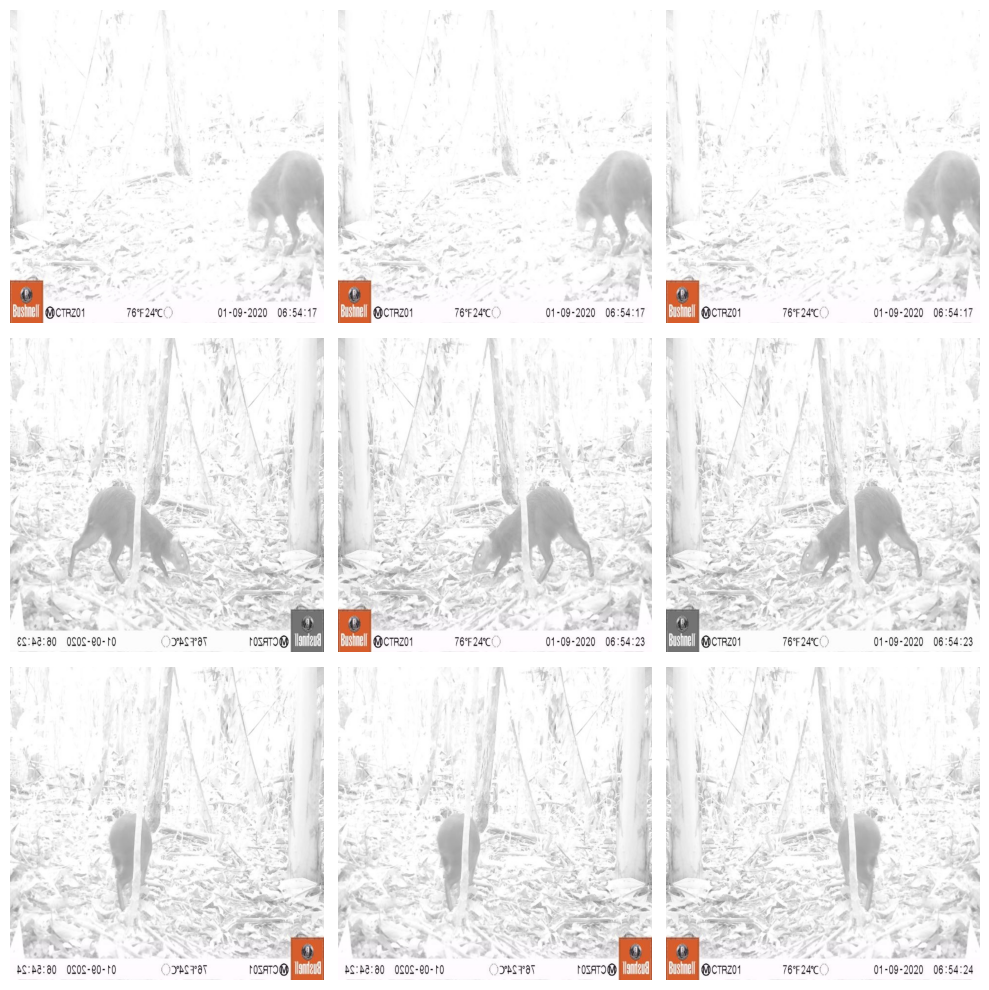

In [59]:
# Show selected images
show_image_grid(train_images)

En efecto, el dataset está compuesto por imagenes de las calles de Bangladesh, en las cuales podemos ver diversos actores viales, en diferentes horas del día.

## 1.4 Tamaño de las imágenes

Para comprobar el tamaño de las imagénes seleccionaremos la primera imagén:

In [64]:
# First image
first_image = train_images[0]
name_first_image = os.path.basename(first_image)
labels_first_image_path = os.path.join(label_train_path, f"{name_first_image.split('.')[0]}.txt")
labels_first_image_path

'images/train/labels\\01090062_JPG.txt'

Y para mostrar una sola imagén usaremos la siguiente función:


In [67]:
def show_image(img, title=None):
  if not title:
    title = os.path.basename(first_image)
  plt.imshow(img)
  plt.axis('off')
  plt.title('Imagen de muestra')
  plt.show()

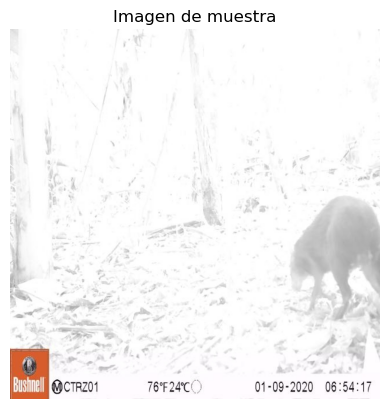

In [69]:
# Show first image
img = cv2.imread(first_image)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
show_image(img)

Podemos observar que las imagenes tienen un ancho de 1920 y un alto de 1080.

In [72]:
# Showing height and widht of the first image
height, width = img.shape[:2]
print(f"Width: {width}",  f"Height: {height}")

Width: 640 Height: 640


Esto se traduce en un vector final con muchos datos, es por esta razón se decide redimensionar la imagén a una imagén cuadrada de 640x640, configuración que espera redes neuronales como Yolo para aumentar la velocidad de entrenamiento del modelo y mejorar su rendimiento.

Sin embargo es importante mencionar que se reduciría el nivel de detalle de cada imagen lo que puede provocar peores metrícas en el modelo.

## 1.5 Archivo de etiquetas

Podemos encontrar que en los archivos descargados, encontramos un archivo txt en el que se encuentra información las distintas clases

### 1.5.1 Formato de los Labels

In [78]:
# Ruta base para las etiquetas
labels_dir = "images/train/labels/"
name_first_image = "06160768_JPG"  # Nombre base de la imagen sin el hash

# Verificar si el directorio existe
if os.path.exists(labels_dir):
    print(f"Directorio encontrado: {labels_dir}")
else:
    print(f"El directorio {labels_dir} no existe. Verifica la ruta.")

# Listar todos los archivos en la carpeta de etiquetas para ver qué archivos existen
print("\nArchivos en el directorio de etiquetas:")
all_label_files = glob.glob(os.path.join(labels_dir, "*.txt"))
for file in all_label_files:
    print(file)

# Intentar encontrar el archivo de etiqueta que sigue el patrón '06160768_JPG.rf.[hash].txt'
label_files = glob.glob(os.path.join(labels_dir, f"{name_first_image}.rf.*.txt"))
print("\nResultado de la búsqueda con el patrón:")
print(label_files)

# Verificar si se encontró algún archivo
if label_files:
    # Usar el primer archivo encontrado (si hay más de uno)
    labels_first_image_path = label_files[0]
    with open(labels_first_image_path, 'r') as f:
        labels = f.readlines()
        print(f"\nLabels for {os.path.basename(labels_first_image_path)}:")

    # Procesar e imprimir cada línea del archivo
    for label in labels:
        label = label.strip().split()
        class_id = int(label[0])
        x_center = float(label[1])
        y_center = float(label[2])
        width = float(label[3])
        height = float(label[4])

        print(f"Clase: {class_id}, x_centro: {x_center}, y_centro: {y_center}, ancho: {width}, altura: {height}")
else:
    print(f"\nNo se encontró ningún archivo de etiqueta para {name_first_image}.")





Directorio encontrado: images/train/labels/

Archivos en el directorio de etiquetas:
images/train/labels\01090062_JPG.rf.4009eaa55ec443d82731319f10650424.txt
images/train/labels\01090062_JPG.rf.9352c26199a2459efd3508cebc4bf47e.txt
images/train/labels\01090062_JPG.rf.ad2ceb59b2d23d21baad98cbbb8c8e71.txt
images/train/labels\01090065_JPG.rf.4189266056debe8954092f56e49f2970.txt
images/train/labels\01090065_JPG.rf.7475f200a10684bbea8fd20a77587d8c.txt
images/train/labels\01090065_JPG.rf.a81cfc0263acf3f61a905b46fb11567d.txt
images/train/labels\01090066_JPG.rf.489bd77bf2abc59d6b0ced9dbe803057.txt
images/train/labels\01090066_JPG.rf.b556b54eb8ea5a4a2f26e57c40ddf908.txt
images/train/labels\01090066_JPG.rf.e9c526bdf969447c1cb740062a5c505b.txt
images/train/labels\01090067_JPG.rf.80f9d7be1cb272c8a28ef3fbe8663a15.txt
images/train/labels\01090067_JPG.rf.9f548f27da1709a682b3a68c108162d3.txt
images/train/labels\01090067_JPG.rf.fbf2ceaaaaae1fd0b0ffb92fda3e4c50.txt
images/train/labels\01090080_JPG.rf.0a0

Podemos comprobar que el formato de los archivos en la carpeta de labels concuerda con los esperados por YOLO, los cuales son:

> `class_id x_center y_center width height`


### 1.5.2 Asignación de las clases

Sabemos que cada archivo de label nos dice en dónde se encuentra ubicado cada objeto/clase. Sin embargo esta asignación se hace con un ID, para saber a qué objeto corresponde, podemos hacer uso del archivo *classes.txt*

In [84]:
import os
import yaml

# Definir la ruta del archivo data.yaml
data_yaml_path = os.path.join('images/data.yaml')

# Leer el archivo data.yaml para obtener las clases
with open(data_yaml_path, 'r') as file:
    data = yaml.safe_load(file)
    classes = data['names']  # Extrae la lista o diccionario de nombres desde el YAML

# Verificar si 'names' es un diccionario
if isinstance(classes, dict):
    # Convertir el diccionario en una lista ordenada por claves
    classes = [classes[key] for key in sorted(classes.keys())]

# Mostrar el ID y la clase
for i, class_name in enumerate(classes):
    print(f"ID {i} - Class: {class_name}")



ID 0 - Class: Armadillo
ID 1 - Class: Black Agouti
ID 2 - Class: Collared Peccary
ID 3 - Class: White-lipped Peccary
ID 4 - Class: Crypturellus
ID 5 - Class: Giant Anteater
ID 6 - Class: White-tailed Deer
ID 7 - Class: Lowland Tapir
ID 8 - Class: Margarita Island Capuchin
ID 9 - Class: Ocelote
ID 10 - Class: Rodent
ID 11 - Class: Salvins Curassow
ID 12 - Class: South American Coati
ID 13 - Class: Southern Tamandua
ID 14 - Class: Spixs Guan
ID 15 - Class: Spotted Paca
ID 16 - Class: Squirrel
ID 17 - Class: Tayra


Finalmente YOLO asigna colores a sus clases, por lo cual haremos lo mismo, para que al momento de graficar sea más rápida la comparación

In [87]:
color_mapping = {
    0: (0, 0, 204),      # Armadillo - Azul oscuro
    1: (0, 128, 255),    # Black Agouti - Azul claro
    2: (0, 255, 255),    # Collared Peccary - Cian
    3: (127, 255, 212),  # White-lipped Peccary - Verde aguamarina
    4: (34, 139, 34),    # Crypturellus - Verde
    5: (204, 0, 0),      # Giant Anteater - Rojo oscuro
    6: (173, 255, 47),   # White-tailed Deer - Amarillo verdoso
    7: (128, 0, 128),    # Lowland Tapir - Púrpura
    8: (255, 215, 0),    # Margarita Island Capuchin - Dorado
    9: (255, 69, 0),     # Ocelote - Naranja rojizo
    10: (255, 140, 0),   # Rodent - Naranja oscuro
    11: (0, 100, 0),     # Salvins Curassow - Verde bosque
    12: (255, 165, 0),   # South American Coati - Naranja fuerte
    13: (64, 224, 208),  # Southern Tamandua - Turquesa
    14: (75, 0, 130),    # Spixs Guan - Índigo
    15: (255, 20, 147),  # Spotted Paca - Rosa profundo
    16: (0, 255, 127),   # Squirrel - Verde primaveral
    17: (105, 105, 105)  # Tayra - Gris oscuro
}



# 2. Modelo Base: Red Neuronal Preentrenada

## 2.1 Justificación Modelo Preentrenado YOLO


Como se mencionó anteriormente, los archivos y la estructura del dataset concuerdan perfectamente con los requisitos esperados por YOLO, lo que garantiza una integración fluida y eficiente. La organización sigue el formato adecuado, con un archivo YAML que describe las clases, las rutas de las imágenes de entrenamiento y validación, así como las anotaciones en formato YOLO para cada imagen. Esta conformidad permite que el modelo se entrene y valide sin problemas, maximizando el rendimiento y reduciendo posibles errores durante el proceso.

Además, Elegir YOLO para este proyecto tiene múltiples justificaciones sólidas. En primer lugar, YOLO es uno de los modelos de detección de objetos más rápidos y precisos, lo que lo convierte en una excelente opción para aplicaciones en tiempo real. También es altamente eficiente en cuanto a recursos, permitiendo entrenar en una amplia variedad de GPUs, desde equipos de alto rendimiento hasta configuraciones más limitadas. Por último, la amplia comunidad y soporte de YOLO facilitan la implementación de mejoras y la resolución de problemas en caso de que surjan, lo que lo convierte en una opción robusta y ampliamente adoptada.

## 2.1.1 Prueba de la estructura

Como última comprobación de que los datos se encuentran en la estructura que Yolo espera, Podemos crear una función que reciba una imagén y el nombre del dataset, y que nos dibuje la imagén con sus respectivas etiquetas.  

Archivo de etiquetas encontrado: images/train/labels/06190171_JPG.rf.8a85d248bdb369a491b9f349dbbecf59.txt


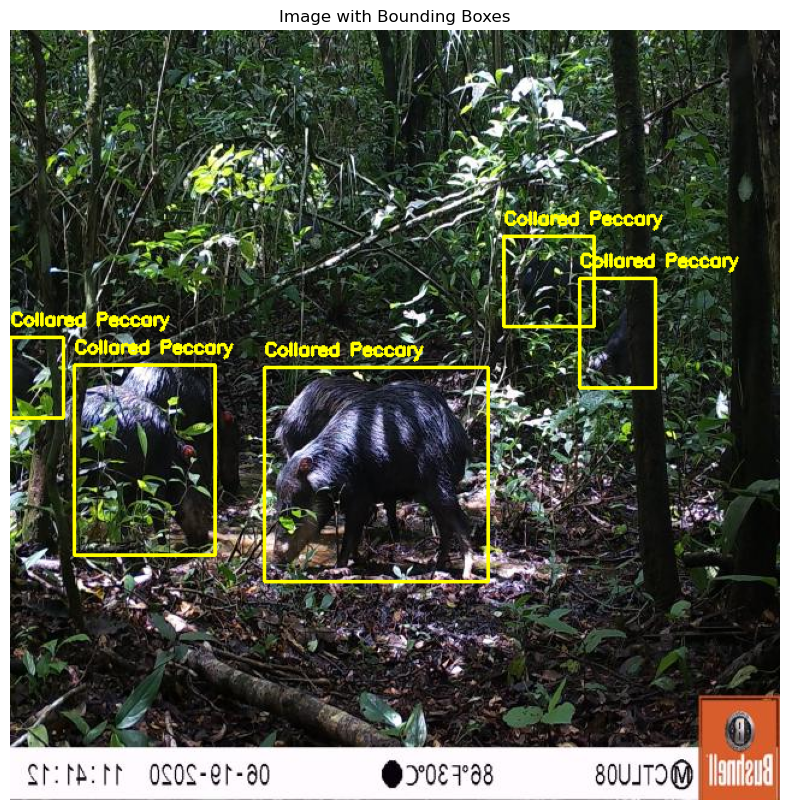

In [93]:
import cv2
import matplotlib.pyplot as plt

# Mapeo de ID de clase a nombres de animales
class_names = {
    0: "Armadillo",
    1: "Black Agouti",
    2: "Collared Peccary",
    3: "White-lipped Peccary",
    4: "Crypturellus",
    5: "Giant Anteater",
    6: "White-tailed Deer",
    7: "Lowland Tapir",
    8: "Margarita Island Capuchin",
    9: "Ocelote",
    10: "Rodent",
    11: "Salvins Curassow",
    12: "South American Coati",
    13: "Southern Tamandua",
    14: "Spixs Guan",
    15: "Spotted Paca",
    16: "Squirrel",
    17: "Tayra"
}


def show_image_and_labels(path_image, dataset, custom_img=None, custom_labels=None):
    # Cargar la imagen
    img = cv2.imread(path_image)

    # Verificar si la imagen se cargó correctamente
    if img is None:
        print(f"No se pudo cargar la imagen: {path_image}")
        return None

    img_height, img_width = img.shape[:2]

    # Verificar si el archivo de etiquetas existe
    if not os.path.exists(labels_image_path):
        print(f"No se encontró el archivo de etiqueta en la ruta: {labels_image_path}")
        return img

    print(f"Archivo de etiquetas encontrado: {labels_image_path}")

    # Escala de fuente para el texto en la imagen
    font_scale = img_width / 640 * 0.5

    # Leer y procesar las etiquetas
    with open(labels_image_path, 'r') as f:
        labels = f.readlines()
    for label in labels:
        label = label.strip().split()
        class_id = int(label[0])
        x_center = float(label[1]) * img_width
        y_center = float(label[2]) * img_height
        width = float(label[3]) * img_width
        height = float(label[4]) * img_height
        x1 = int(x_center - width / 2)
        y1 = int(y_center - height / 2)
        x2 = int(x_center + width / 2)
        y2 = int(y_center + height / 2)

        # Obtener el nombre del animal a partir del ID
        class_name = class_names.get(class_id, "Unknown")

        # Dibujar el cuadro delimitador en la imagen
        color = color_mapping.get(class_id, (255, 255, 255))  # Color por defecto blanco si no se encuentra en color_mapping
        cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
        cv2.putText(img, class_name, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, font_scale, color, 2)

    return img

def display_image(img, title="Image with Bounding Boxes"):
    # Convertir la imagen de BGR a RGB para mostrar con matplotlib
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 10))
    plt.imshow(img_rgb)
    plt.title(title)
    plt.axis("off")
    plt.show()

# Ruta de ejemplo para la imagen y el archivo de etiquetas
first_image = "images/train/images/06190171_JPG.rf.8a85d248bdb369a491b9f349dbbecf59.jpg"
labels_image_path = "images/train/labels/06190171_JPG.rf.8a85d248bdb369a491b9f349dbbecf59.txt"

# Llamada a la función
img = show_image_and_labels(first_image, labels_image_path)

# Mostrar la imagen si se cargó correctamente
if img is not None:
    display_image(img)






Esta función busca en la carpeta especifica la imagén y luego en la carpeta de labels busca sus etiquetas, para luego pintarlas en el formato de YOLO **class_id, x_center, y_center, width, height**

Finalmente, podemos observar que la primera imágen cuenta con una motocileta, una persona y un vehículo rickshow, todos estos objetos delimitados correctamente por el bounding box escrito en el archivo de labels

## 2.2 Preprocesamiento de las imagenes

### 2.2.1 Letterbox

A pesar de que las imagenes ya se encuentran en la estructura esperada por YOLO, es necesario realizar una redimensión de la misma, a un formato de 640x640, el cual es una de las configuraciones de YOLO. Para realizar esto usaremos letterboxing

El letterbox es una técnica que se usa para ajustar una imagen de entrada a las dimensiones esperadas, sin distorsionar su proporción original. Se agrega un borde (padding) para que la imagen mantenga su relación de aspecto, lo que es crucial para evitar deformaciones que podrían afectar el rendimiento de la detección de objetos.

In [100]:
def letterbox_image(image, new_shape=(640, 640), color=(114, 114, 114)):
    shape = image.shape[:2]  # altura, anchura
    ratio = min(new_shape[0] / shape[0], new_shape[1] / shape[1])

    new_unpad = (int(shape[1] * ratio), int(shape[0] * ratio))

    # Padding
    dw = (new_shape[1] - new_unpad[0]) / 2
    dh = (new_shape[0] - new_unpad[1]) / 2

    resized_image = cv2.resize(image, new_unpad, interpolation=cv2.INTER_LINEAR)

    top, bottom = int(np.floor(dh)), int(np.ceil(dh))
    left, right = int(np.floor(dw)), int(np.ceil(dw))
    letterbox_image = cv2.copyMakeBorder(resized_image, top, bottom, left, right, cv2.BORDER_CONSTANT, value=color)

    return letterbox_image, ratio, dw, dh

si la probamos con la primera imagén:

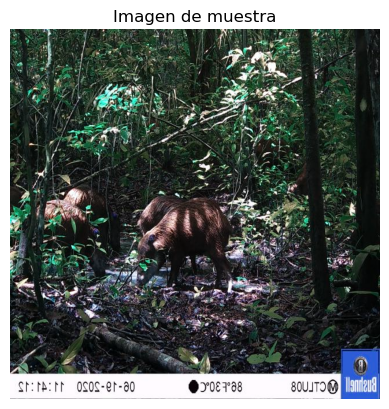

In [103]:
img = cv2.imread(first_image)
resized_img, ratio, dw, dh  = letterbox_image(img)
show_image(resized_img, title=os.path.basename(first_image) + ' resized')

podemos observar que ahora es una imagén cuadrada y que su tamaño es:


In [106]:
# Showing size of image
height, width = resized_img.shape[:2]
print(f"Width: {width}",  f"Height: {height}")

Width: 640 Height: 640


### 2.2.2 Bounding boxes

Ya que las imagenes fueron redimensionadas, las coordenadas de cada label ya no concordarían. Como podemos observar en la siguiente fragmento de código:

Archivo de etiquetas encontrado: images/train/labels/06190171_JPG.rf.8a85d248bdb369a491b9f349dbbecf59.txt


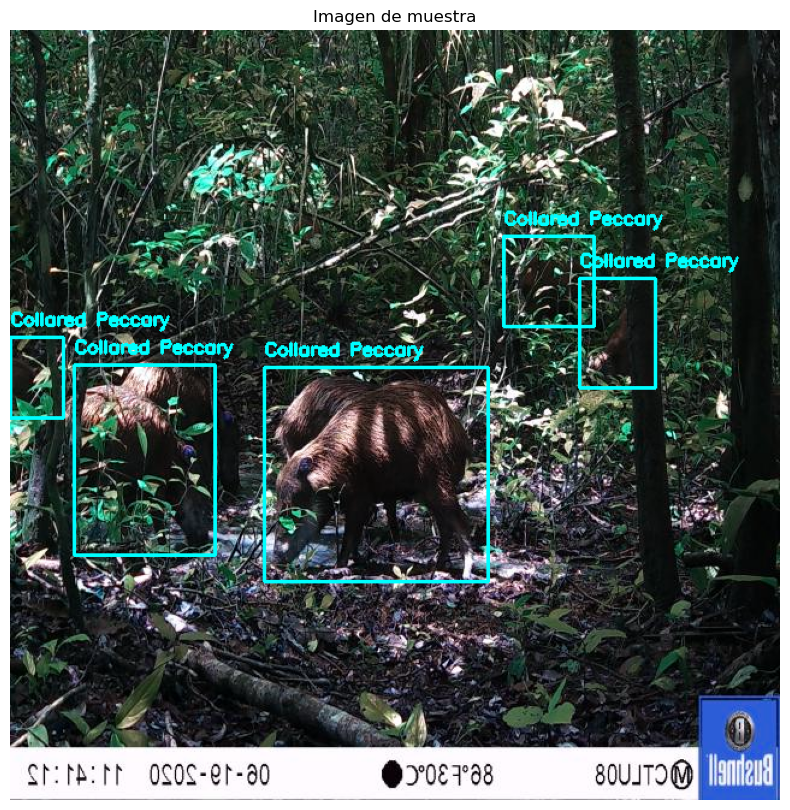

In [110]:
# Bouding boxes in resized image
img2 = show_image_and_labels(first_image, 'train', custom_img=resized_img)
plt.figure(figsize=(10, 10))
show_image(img2, title=os.path.basename(first_image) + ' resized')

Debemos generar una función que nos ayude a redimensionar cada bounding box

In [113]:
def adjust_labels(label_path,img_shape, new_shape, ratio, dw, dh):
    adjusted_labels = []

    with open(label_path, 'r') as f:
        labels = f.readlines()

    new_labels = []
    img_height, img_width = img_shape[:2]
    new_height, new_width = new_shape

    for label in labels:
        class_id, x_center, y_center, width, height = map(float, label.strip().split())

        # Escalar las coordenadas al nuevo tamaño de la imagen
        x_center_new = ((x_center * img_width * ratio + dw) / new_width)
        y_center_new = ((y_center * img_height * ratio + dh) / new_height)

        width_new = (width * img_width * ratio / new_width)
        height_new = (height * img_height * ratio / new_height)


        new_labels.append(f"{int(class_id)} {x_center_new} {y_center_new} {width_new} {height_new}")

    return new_labels


que si lo probamos para la primera imágen

Archivo de etiquetas encontrado: images/train/labels/06190171_JPG.rf.8a85d248bdb369a491b9f349dbbecf59.txt


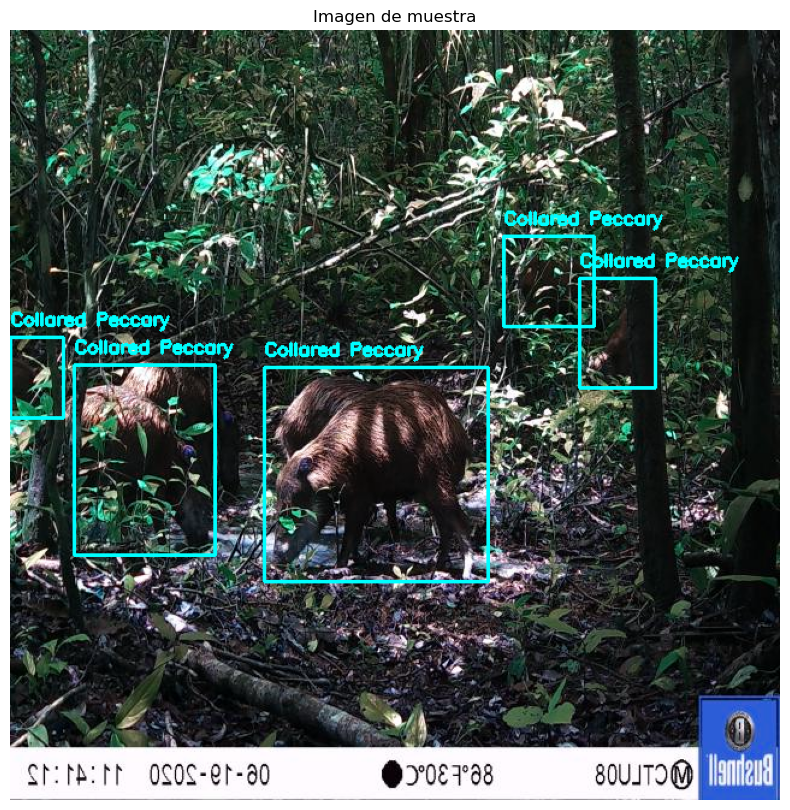

In [116]:
# Fixed bounding boxes
plt.figure(figsize=(10, 10))
adjusted_labels = adjust_labels(labels_first_image_path, img.shape, resized_img.shape[:2], ratio, dw, dh)
fixed_img = show_image_and_labels(first_image, 'train', custom_img=resized_img, custom_labels=adjusted_labels)
show_image(fixed_img, title=os.path.basename(first_image) + ' resized')

Podemos ver que los bounding boxes fueron correctamente ajustados

### 2.2.3 Aplicandolo a todas las imagenes

Finalmente procederemos a aplicar este mismo proceso a todas las imagenes del dataset

In [121]:
import os
import cv2
import glob

def apply_letterbox_to_dataset(image_paths, images_dir, labels_dir):
    for image_path in image_paths:
        # Leer la imagen
        img = cv2.imread(image_path)
        if img is None:
            print(f"Error: No se pudo leer la imagen {image_path}. Verifica la ruta o el archivo.")
            continue

        resized_img, ratio, dw, dh = letterbox_image(img)

        # Buscar el archivo de etiquetas correspondiente
        label_base_name = os.path.basename(image_path).split('.')[0]
        label_path_pattern = os.path.join(labels_dir, f"{label_base_name}.rf.*.txt")
        label_files = glob.glob(label_path_pattern)

        if not label_files:
            print(f"No se encontró archivo de etiqueta para: {image_path}")
            continue

        label_path = label_files[0]  # Usar el primer archivo que coincida

        # Ajustar etiquetas
        adjusted_labels = adjust_labels(label_path, img.shape, resized_img.shape[:2], ratio, dw, dh)

        # Guardar la imagen redimensionada
        output_image_path = os.path.join(images_dir, os.path.basename(image_path))
        cv2.imwrite(output_image_path, resized_img)

        # Guardar las etiquetas ajustadas
        with open(label_path, 'w') as f:
            f.writelines(adjusted_labels)

        print(f"Procesado: {image_path}")

def adjust_labels(label_path, img_shape, new_shape, ratio, dw, dh):
    adjusted_labels = []
    with open(label_path, 'r') as f:
        labels = f.readlines()

    for label in labels:
        # Validar formato de las líneas
        label = label.strip().split()
        if len(label) < 5:
            print(f"Línea no válida en {label_path}: {label}")
            continue

        class_id = label[0]
        x = float(label[1]) * img_shape[1]
        y = float(label[2]) * img_shape[0]
        w = float(label[3]) * img_shape[1]
        h = float(label[4]) * img_shape[0]

        # Ajustar coordenadas
        x = (x * ratio + dw) / new_shape[1]
        y = (y * ratio + dh) / new_shape[0]
        w = w * ratio / new_shape[1]
        h = h * ratio / new_shape[0]

        # Crear línea ajustada
        adjusted_labels.append(f"{class_id} {x:.6f} {y:.6f} {w:.6f} {h:.6f}\n")

    return adjusted_labels


In [123]:
import os

def verify_image_paths(image_paths):
    valid_paths = []
    for image_path in image_paths:
        if not os.path.exists(image_path):
            print(f"Ruta no encontrada: {image_path}")
        elif os.path.getsize(image_path) == 0:
            print(f"Archivo vacío: {image_path}")
        else:
            valid_paths.append(image_path)
    return valid_paths

# Llama a la función para verificar
train_images = verify_image_paths(train_images)


En cada uno de los dataset

In [126]:
apply_letterbox_to_dataset(train_images, images_train_path, label_train_path)
apply_letterbox_to_dataset(val_images, images_val_path, label_val_path)
apply_letterbox_to_dataset(test_images, images_test_path, label_test_path)

Procesado: images/train/images\01090062_JPG.rf.4009eaa55ec443d82731319f10650424.jpg
Procesado: images/train/images\01090062_JPG.rf.9352c26199a2459efd3508cebc4bf47e.jpg
Procesado: images/train/images\01090062_JPG.rf.ad2ceb59b2d23d21baad98cbbb8c8e71.jpg
Procesado: images/train/images\01090065_JPG.rf.4189266056debe8954092f56e49f2970.jpg
Procesado: images/train/images\01090065_JPG.rf.7475f200a10684bbea8fd20a77587d8c.jpg
Procesado: images/train/images\01090065_JPG.rf.a81cfc0263acf3f61a905b46fb11567d.jpg
Procesado: images/train/images\01090066_JPG.rf.489bd77bf2abc59d6b0ced9dbe803057.jpg
Procesado: images/train/images\01090066_JPG.rf.b556b54eb8ea5a4a2f26e57c40ddf908.jpg
Procesado: images/train/images\01090066_JPG.rf.e9c526bdf969447c1cb740062a5c505b.jpg
Procesado: images/train/images\01090067_JPG.rf.80f9d7be1cb272c8a28ef3fbe8663a15.jpg
Procesado: images/train/images\01090067_JPG.rf.9f548f27da1709a682b3a68c108162d3.jpg
Procesado: images/train/images\01090067_JPG.rf.fbf2ceaaaaae1fd0b0ffb92fda3e4

Para finalmente, comprobar que todas las imagenes fueron correctamente redimensionadas:

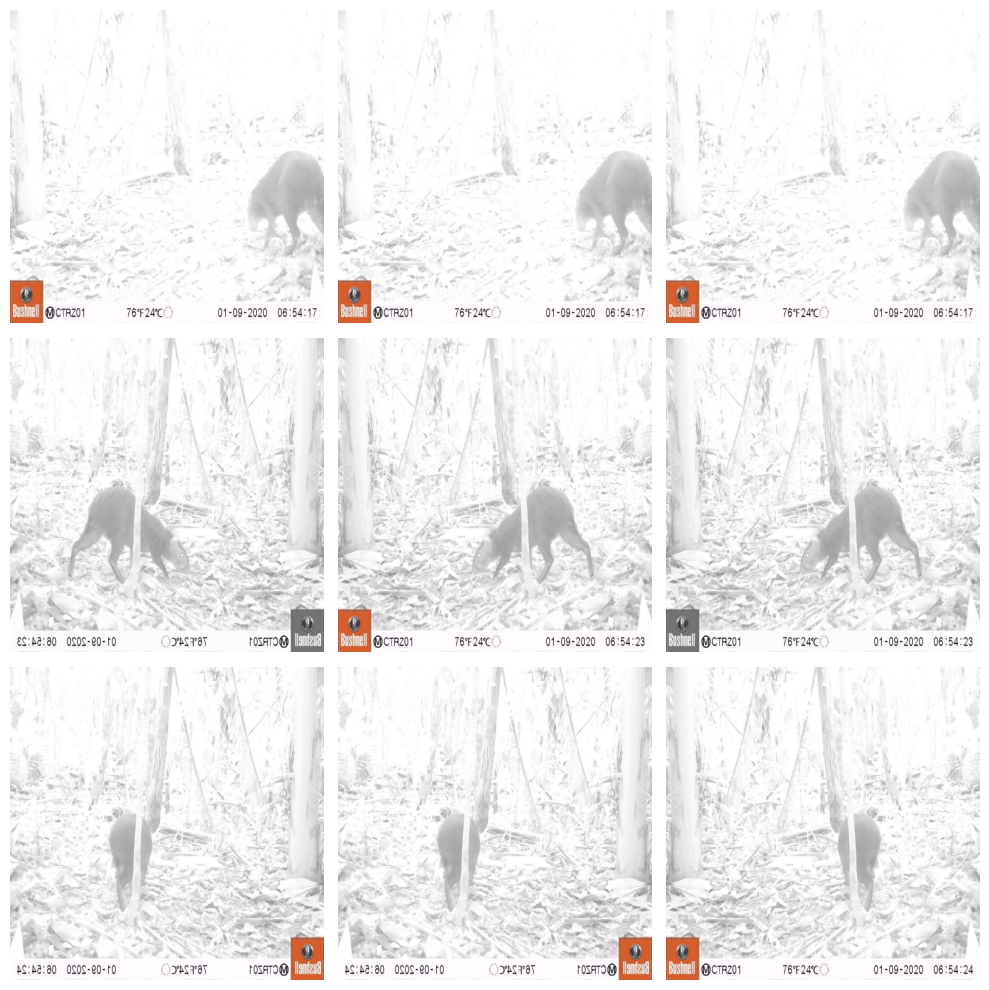

In [127]:
# Show selected images
show_image_grid(train_images)

## 2.3. Configuración del modelo base

Ya que tenemos las imagenes preprocesadas,  procederemos a crear un archivo adicional yaml de configuración de nuestro modelo YOLO

In [140]:
import os.path as osp

# Lista de clases con sus respectivos nombres
corrected_class_names = {
    0: "Armadillo",
    1: "Black Agouti",
    2: "Collared Peccary",
    3: "White-lipped Peccary",  # Renombrada de Clase 20
    4: "Crypturellus",
    5: "Giant Anteater",
    6: "White-tailed Deer",     # Renombrada de Clase 21
    7: "Lowland Tapir",
    8: "Margarita Island Capuchin",
    9: "Ocelote",
    10: "Rodent",
    11: "Salvins Curassow",
    12: "South American Coati",
    13: "Southern Tamandua",
    14: "Spixs Guan",
    15: "Spotted Paca",
    16: "Squirrel",
    17: "Tayra"
}

# Configuración del archivo YAML del dataset
yaml_data_content = f"""\
path: 'C:/Users/proyecto/Documents/Proyecto/MINE-4210_202420_ADL/Proyecto_Ajustado/images'  # Ruta absoluta al directorio raíz de los datos
train: 'C:/Users/proyecto/Documents/Proyecto/MINE-4210_202420_ADL/Proyecto_Ajustado/images/train/images'  # Ruta absoluta a las imágenes de entrenamiento
val: 'C:/Users/proyecto/Documents/Proyecto/MINE-4210_202420_ADL/Proyecto_Ajustado/images/valid/images'  # Ruta absoluta a las imágenes de validación
test: 'C:/Users/proyecto/Documents/Proyecto/MINE-4210_202420_ADL/Proyecto_Ajustado/images/test/images'  # Ruta absoluta a las imágenes de prueba (opcional)

names:
"""

# Agregar nombres de clases al contenido del YAML del dataset
for class_id, name in corrected_class_names.items():
    yaml_data_content += f"  {class_id}: \"{name}\"\n"

yaml_data_content += "nc: 18\n"  # Número total de clases

# Archivo YAML del modelo con ajustes en el Backbone y Neck
yaml_model_content = f"""\
nc: 18  # Número de clases
depth_multiple: 0.33  # Multiplicador de profundidad
width_multiple: 0.50  # Multiplicador de ancho

backbone:
  [[-1, 1, Conv, [64, 3, 1]],  # Convolución 3x3 adicional
   [-1, 1, Conv, [128, 3, 2]],
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],
   [-1, 1, SPPF, [1024, 5]]]  # Bloque SPPF adicional para mejor extracción

neck:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],
   [-1, 3, BottleneckCSP, [256]],
   [-1, 1, Conv, [128, 3, 2]],
   [-1, 1, Detect, [nc]]]  # Detección final adaptada a nc
"""

# Rutas para guardar los archivos YAML
DATA_YAML_PATH = 'images/data.yaml'
MODEL_YAML_PATH = 'images/yolov8_custom.yaml'

# Eliminar archivos YAML existentes para evitar conflictos
for path in [DATA_YAML_PATH, MODEL_YAML_PATH]:
    if osp.exists(path):
        os.remove(path)

# Guardar el archivo YAML del dataset
with open(DATA_YAML_PATH, 'w') as yaml_file:
    yaml_file.write(yaml_data_content)

# Guardar el archivo YAML del modelo
with open(MODEL_YAML_PATH, 'w') as yaml_file:
    yaml_file.write(yaml_model_content)

print(f"Archivo YAML guardado:\n - Dataset: {DATA_YAML_PATH}\n - Modelo: {MODEL_YAML_PATH}")




Archivo YAML guardado en: images/data.yaml


Este script genera dos archivos YAML esenciales para entrenar un modelo de detección de objetos adaptado a la identificación de especies animales capturadas por cámaras trampa. El primer archivo, relacionado con el dataset, organiza las rutas absolutas de las imágenes de entrenamiento, validación y prueba, además de mapear los nombres de las 18 clases con sus respectivos identificadores. El segundo archivo configura el modelo YOLOv8 con mejoras arquitectónicas, incluyendo filtros adicionales de 3x3 en el Backbone para una extracción más detallada de características, y bloques personalizados en el Neck basados en PANet para optimizar la detección en múltiples escalas. Ambos ajustes garantizan que el modelo sea robusto, eficiente y adaptado a la complejidad visual del entorno natural.

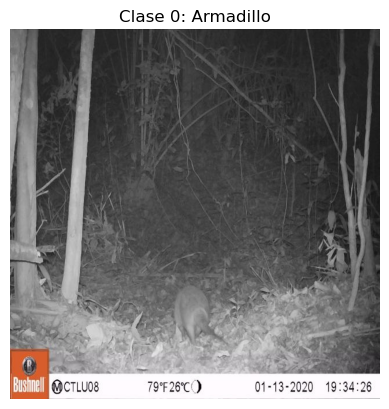

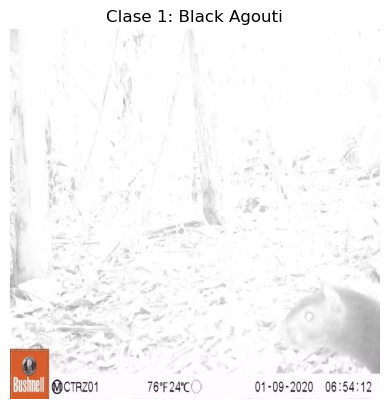

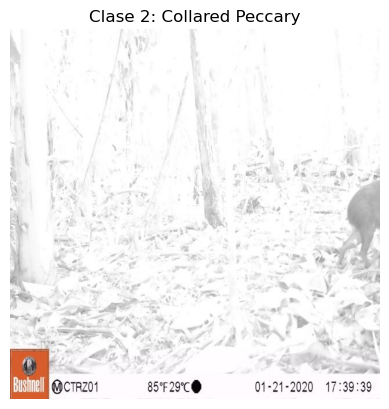

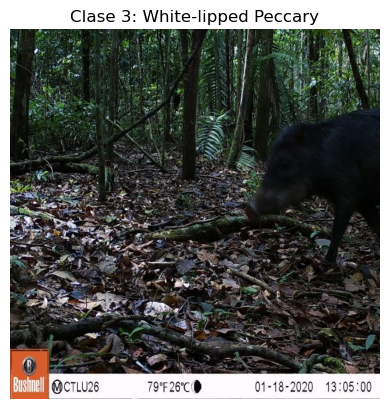

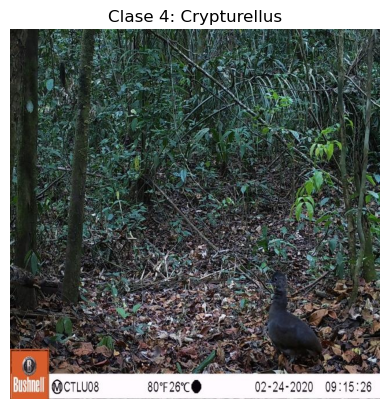

...

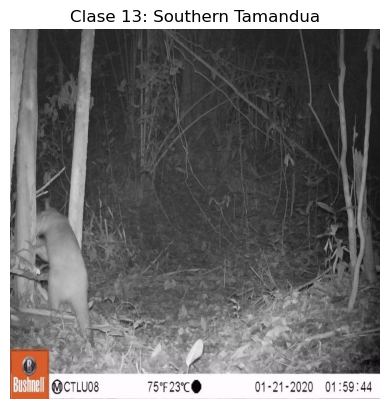

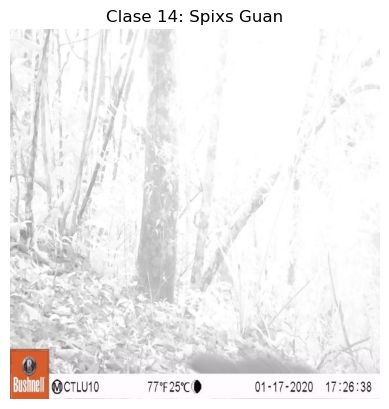

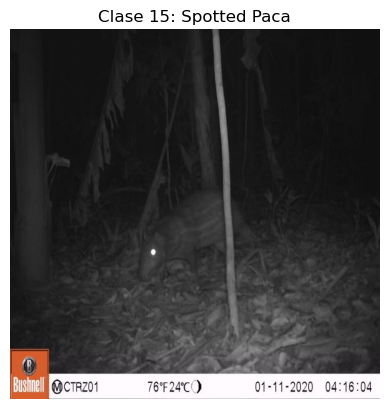

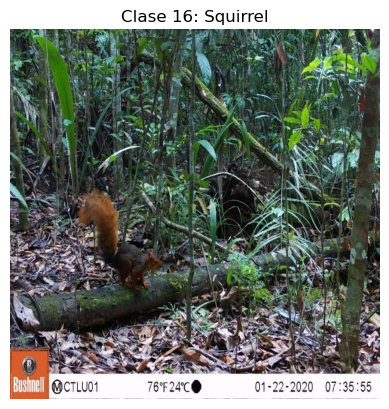

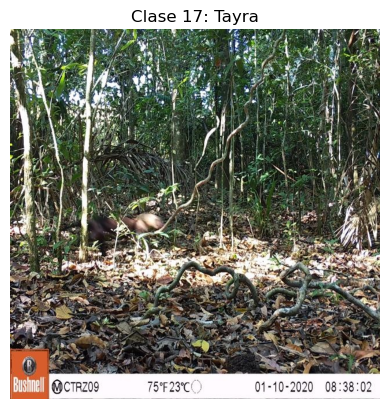

In [142]:
# Rutas a las imágenes y etiquetas
IMAGE_PATH = 'C:/Users/proyecto/Documents/Proyecto/MINE-4210_202420_ADL/Proyecto_Ajustado/images/test/images'
LABEL_PATH = 'C:/Users/proyecto/Documents/Proyecto/MINE-4210_202420_ADL/Proyecto_Ajustado/images/test/labels'

# Número de clases
num_classes = 18
class_names = [
    "Armadillo",
    "Black Agouti",
    "Collared Peccary",
    "White-lipped Peccary",  # Renombrada de Clase 20
    "Crypturellus",
    "Giant Anteater",
    "White-tailed Deer",     # Renombrada de Clase 21
    "Lowland Tapir",
    "Margarita Island Capuchin",
    "Ocelote",
    "Rodent",
    "Salvins Curassow",
    "South American Coati",
    "Southern Tamandua",
    "Spixs Guan",
    "Spotted Paca",
    "Squirrel",
    "Tayra"
]

# Diccionario para almacenar imágenes de cada clase
class_images = {i: [] for i in range(num_classes)}

# Buscar imágenes por clase
for label_file in glob.glob(os.path.join(LABEL_PATH, "*.txt")):
    with open(label_file, 'r') as f:
        for line in f:
            class_id = int(line.split()[0])
            if class_id < num_classes:  # Asegúrate de que está dentro del rango
                image_name = os.path.basename(label_file).replace('.txt', '.jpg')
                image_path = os.path.join(IMAGE_PATH, image_name)
                if os.path.exists(image_path):
                    class_images[class_id].append(image_path)

# Mostrar una imagen por clase
for class_id, images in class_images.items():
    if images:
        img_path = images[0]  # Selecciona la primera imagen de la clase
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir BGR a RGB
        plt.imshow(img)
        plt.title(f"Clase {class_id}: {class_names[class_id]}")
        plt.axis('off')
        plt.show()
    else:
        print(f"No se encontraron imágenes para la clase {class_id}: {class_names[class_id]}")

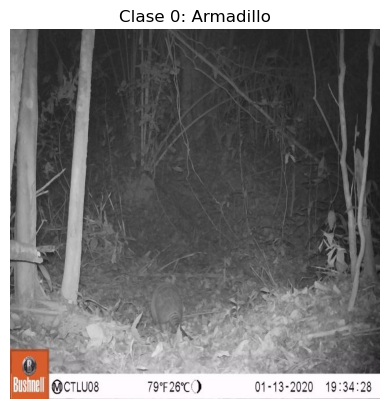

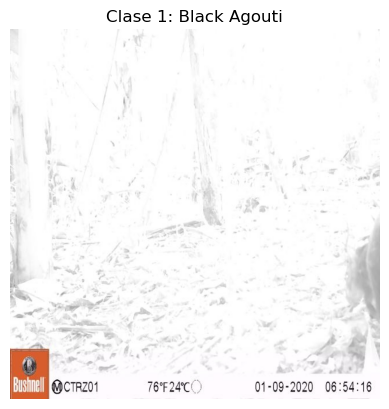

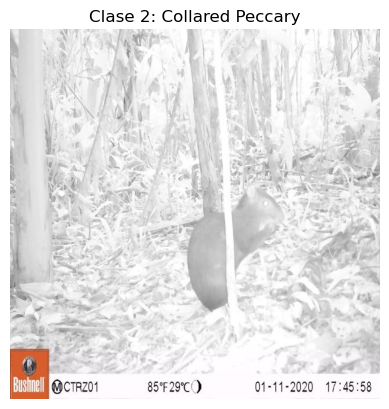

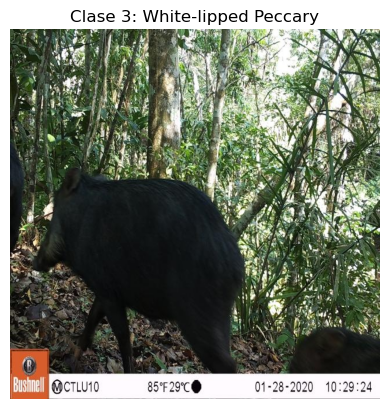

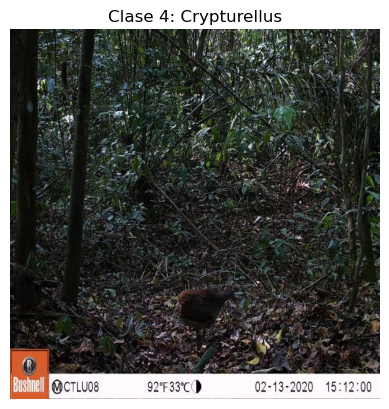

...

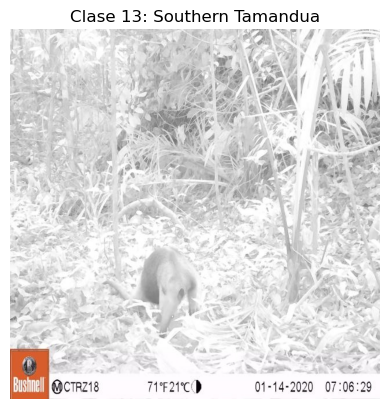

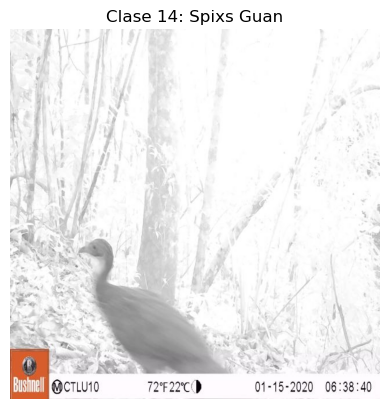

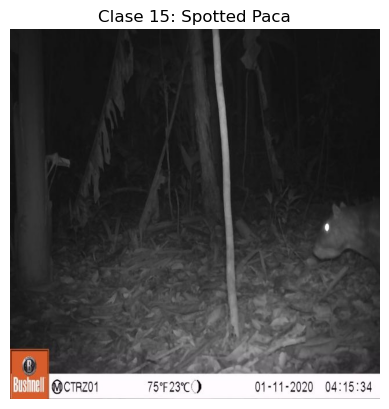

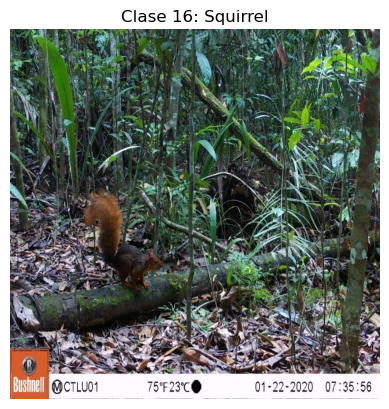

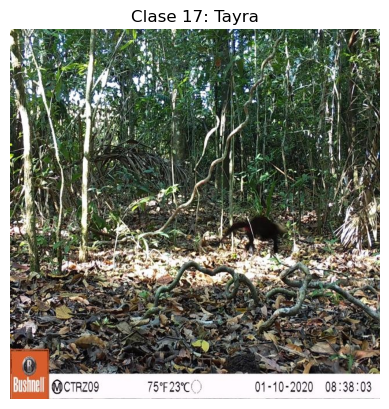

In [144]:
# Rutas a las imágenes y etiquetas
IMAGE_PATH = 'C:/Users/proyecto/Documents/Proyecto/MINE-4210_202420_ADL/Proyecto_Ajustado/images/valid/images'
LABEL_PATH = 'C:/Users/proyecto/Documents/Proyecto/MINE-4210_202420_ADL/Proyecto_Ajustado/images/valid/labels'

# Número de clases
num_classes = 18
class_names = [
    "Armadillo",
    "Black Agouti",
    "Collared Peccary",
    "White-lipped Peccary",  # Renombrada de Clase 20
    "Crypturellus",
    "Giant Anteater",
    "White-tailed Deer",     # Renombrada de Clase 21
    "Lowland Tapir",
    "Margarita Island Capuchin",
    "Ocelote",
    "Rodent",
    "Salvins Curassow",
    "South American Coati",
    "Southern Tamandua",
    "Spixs Guan",
    "Spotted Paca",
    "Squirrel",
    "Tayra"
]


# Diccionario para almacenar imágenes de cada clase
class_images = {i: [] for i in range(num_classes)}

# Buscar imágenes por clase
for label_file in glob.glob(os.path.join(LABEL_PATH, "*.txt")):
    with open(label_file, 'r') as f:
        for line in f:
            class_id = int(line.split()[0])
            if class_id < num_classes:  # Asegúrate de que está dentro del rango
                image_name = os.path.basename(label_file).replace('.txt', '.jpg')
                image_path = os.path.join(IMAGE_PATH, image_name)
                if os.path.exists(image_path):
                    class_images[class_id].append(image_path)

# Mostrar una imagen por clase
for class_id, images in class_images.items():
    if images:
        img_path = images[0]  # Selecciona la primera imagen de la clase
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir BGR a RGB
        plt.imshow(img)
        plt.title(f"Clase {class_id}: {class_names[class_id]}")
        plt.axis('off')
        plt.show()
    else:
        print(f"No se encontraron imágenes para la clase {class_id}: {class_names[class_id]}")

In [150]:
model = YOLO('yolov8n.pt')

In [152]:
!nvidia-smi

Sun Nov 24 16:11:55 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 552.74                 Driver Version: 552.74         CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A40-16C               TCC   |   00000000:02:01.0 Off |                    0 |
| N/A   N/A    P8             N/A /  N/A  |       0MiB /  16384MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

## 2.4 Entrenamiento del modelo

A continuación se procede a entrenar el modelo con las imágenes de la carpeta TRAIN,

**PRECAUCIÓN**: Correr este comando toma al rededor de 3-4 horas, se recomienda solo ejecutar esta parte del notebook una vez y guardar los resultados

<table border="1" cellpadding="10" cellspacing="0">
    <thead>
        <tr>
            <th>Hiperparámetro</th>
            <th>Valor</th>
            <th>Justificación</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td><b>epochs</b></td>
            <td>19</td>
            <td>Se eligieron 19 épocas para equilibrar el tiempo de entrenamiento y la convergencia del modelo. Esto permite que el modelo aprenda de manera efectiva sin sobreajustarse.</td>
        </tr>
        <tr>
            <td><b>imgsz</b></td>
            <td>640</td>
            <td>El tamaño de imagen de 640x640 píxeles es un buen compromiso entre la precisión y la velocidad de entrenamiento. Las imágenes más pequeñas pueden acelerar el entrenamiento, pero pueden perder información visual importante.</td>
        </tr>
        <tr>
            <td><b>batch</b></td>
            <td>16</td>
            <td>Un tamaño de lote de 16 se ha elegido para aprovechar el paralelismo en la GPU sin agotar la memoria disponible. Esto permite un entrenamiento eficiente en términos de tiempo y recursos.</td>
        </tr>
        <tr>
            <td><b>patience</b></td>
            <td>2</td>
            <td>El valor de paciencia de 2 significa que el entrenamiento se detendrá si no hay mejoras en el rendimiento en 2 épocas consecutivas. Esto ayuda a evitar entrenamientos largos innecesarios.</td>
        </tr>
        <tr>
            <td><b>name</b></td>
            <td>train</td>
            <td>El nombre "train" se usa para identificar fácilmente esta corrida de entrenamiento en los registros y checkpoints. Es útil para mantener organizado el proceso de entrenamiento.</td>
        </tr>
    </tbody>
</table>


In [157]:
# Training the model
model.train(data=YAML_PATH, epochs=19, imgsz=640, batch=16, patience=2, name="train")

New https://pypi.org/project/ultralytics/8.3.36 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.2.98  Python-3.12.7 torch-2.5.1+cpu CPU (Intel Xeon Silver 4310 2.10GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=images/data.yaml, epochs=19, time=None, patience=2, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train15, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=F

train: Scanning C:\Users\proyecto\Documents\Proyecto\MINE-4210_202420_ADL\Proyecto_Ajustado\images\train\labels... 1289


train: New cache created: C:\Users\proyecto\Documents\Proyecto\MINE-4210_202420_ADL\Proyecto_Ajustado\images\train\labels.cache
WARNING  Box and segment counts should be equal, but got len(segments) = 4, len(boxes) = 16097. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


val: Scanning C:\Users\proyecto\Documents\Proyecto\MINE-4210_202420_ADL\Proyecto_Ajustado\images\valid\labels... 1863 i


val: New cache created: C:\Users\proyecto\Documents\Proyecto\MINE-4210_202420_ADL\Proyecto_Ajustado\images\valid\labels.cache
Plotting labels to runs\detect\train15\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000455, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs\detect\train15
Starting training for 19 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/19         0G       1.33      3.224      1.425         25        640: 100%|██████████| 811/811 [26:45<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:25


                   all       1881       2260      0.463      0.459      0.387      0.242

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/19         0G      1.252      2.218      1.343         23        640: 100%|██████████| 811/811 [28:55<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:25

                   all       1881       2260      0.464      0.556      0.518       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/19         0G      1.234      1.881      1.325         24        640: 100%|██████████| 811/811 [28:50<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:25

                   all       1881       2260      0.671      0.534      0.594      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/19         0G      1.204      1.638      1.302         25        640: 100%|██████████| 811/811 [28:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:25

                   all       1881       2260      0.619      0.605      0.639      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/19         0G      1.174      1.489      1.283         18        640: 100%|██████████| 811/811 [28:43<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:24

                   all       1881       2260      0.664      0.636       0.69       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/19         0G      1.151      1.381      1.263         27        640: 100%|██████████| 811/811 [28:31<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:25

                   all       1881       2260      0.684      0.624      0.684      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/19         0G      1.123      1.278      1.245         28        640: 100%|██████████| 811/811 [28:44<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:25

                   all       1881       2260      0.726      0.652      0.724      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/19         0G      1.105      1.207      1.233         30        640: 100%|██████████| 811/811 [28:44<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:25

                   all       1881       2260      0.734      0.684      0.743      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/19         0G      1.069      1.145       1.21         26        640: 100%|██████████| 811/811 [28:42<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:25

                   all       1881       2260      0.735      0.735      0.766      0.505


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/19         0G      1.049     0.9097      1.211         16        640: 100%|██████████| 811/811 [27:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:25

                   all       1881       2260      0.792      0.709      0.793      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/19         0G      1.009     0.8307      1.184         21        640: 100%|██████████| 811/811 [27:33<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:25

                   all       1881       2260      0.797      0.745      0.808      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/19         0G     0.9881      0.787      1.174         16        640: 100%|██████████| 811/811 [27:56<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:24

                   all       1881       2260       0.81      0.765      0.831      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/19         0G     0.9605      0.735      1.153         14        640: 100%|██████████| 811/811 [28:02<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:24

                   all       1881       2260      0.812      0.767       0.82      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/19         0G     0.9336     0.6871      1.137         14        640: 100%|██████████| 811/811 [27:56<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:24

                   all       1881       2260      0.803      0.777      0.833      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/19         0G     0.9101     0.6586      1.123         18        640: 100%|██████████| 811/811 [27:56<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:24

                   all       1881       2260      0.837      0.775      0.836      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/19         0G     0.8912      0.619      1.108         16        640: 100%|██████████| 811/811 [27:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:25

                   all       1881       2260      0.851      0.753      0.829      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/19         0G     0.8563     0.5849       1.09         19        640: 100%|██████████| 811/811 [27:43<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:24

                   all       1881       2260       0.84      0.755      0.828      0.564
EarlyStopping: Training stopped early as no improvement observed in last 2 epochs. Best results observed at epoch 15, best model saved as best.pt.
To update EarlyStopping(patience=2) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



17 epochs completed in 8.400 hours.
Optimizer stripped from runs\detect\train15\weights\last.pt, 6.3MB
Optimizer stripped from runs\detect\train15\weights\best.pt, 6.3MB

Validating runs\detect\train15\weights\best.pt...
Ultralytics YOLOv8.2.98  Python-3.12.7 torch-2.5.1+cpu CPU (Intel Xeon Silver 4310 2.10GHz)
Model summary (fused): 168 layers, 3,009,158 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 59/59 [01:08


                   all       1881       2260      0.837      0.775      0.836      0.565
             Armadillo         38         38      0.597      0.921      0.729      0.532
          Black Agouti        156        162      0.825      0.788      0.849      0.579
      Collared Peccary        258        433      0.804      0.823      0.844      0.603
  White-lipped Peccary        126        229      0.739      0.664      0.739      0.527
          Crypturellus         21         24          1      0.704      0.838      0.506
        Giant Anteater        145        145      0.814        0.8      0.852      0.692
     White-tailed Deer        117        118      0.963       0.89      0.919      0.805
         Lowland Tapir        124        125      0.875      0.893      0.905      0.706
Margarita Island Capuchin         51         53      0.673      0.547      0.675        0.4
               Ocelote         62         64      0.983      0.879      0.952      0.625
                Ro

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000289117CBC20>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,

In [159]:
YAML_PATH

'images/data.yaml'

Este entrenamiento duró al rededor de 3 horas, llegando a un total de 23 epocas. Para facilidad de futuros analisis se descargará la carpeta con todos los resultados

### 2.5 Cargando los resultados

In [320]:
import zipfile

# Ruta al archivo zip
zip_path = 'C:\\Users\\proyecto\\Documents\\Proyecto\\MINE-4210_202420_ADL\\Proyecto\\runs.zip'

# Descomprimir el archivo
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall('runs_base')

print("Results loaded!")


Results loaded!


Si necesitamos los resultados en una ejecución, posterior solo debemos subir este archivo zip y correr el siguiente comando:

Debemos notar que esta carpeta solo continen resultados de Train, ya que fueron los datos con los que el algoritmo hizo su entrenamiento

## 2.4 Resultados del modelo Train



Déspues de entrenar el modelo YOLO encontramos una serie de archivos con los resultados del entrenamiento, en esta sección vamos a analizarlos

### 2.4.1 Algunas predicciones

Uno de las imágenes generadas, es el resultado de las predicciones en un conjunto de datos de train

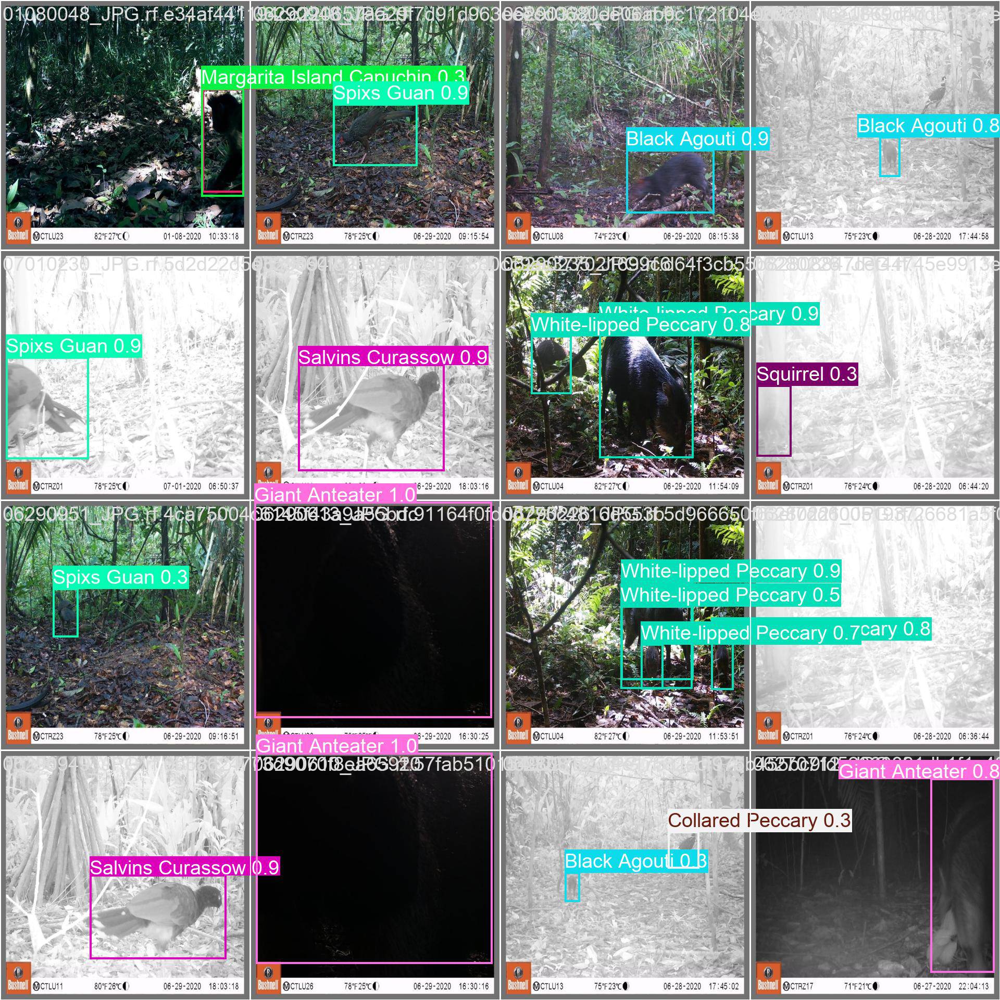

In [166]:
Image.open('runs/detect/train15/val_batch0_pred.jpg')

Podemos observar que en algúnas imagenes se realizaron predicciones erroneas, como por ejemplo en la primera, en donde un 'Margarita Island Capuchin' parece tener más de dos etiquetas.

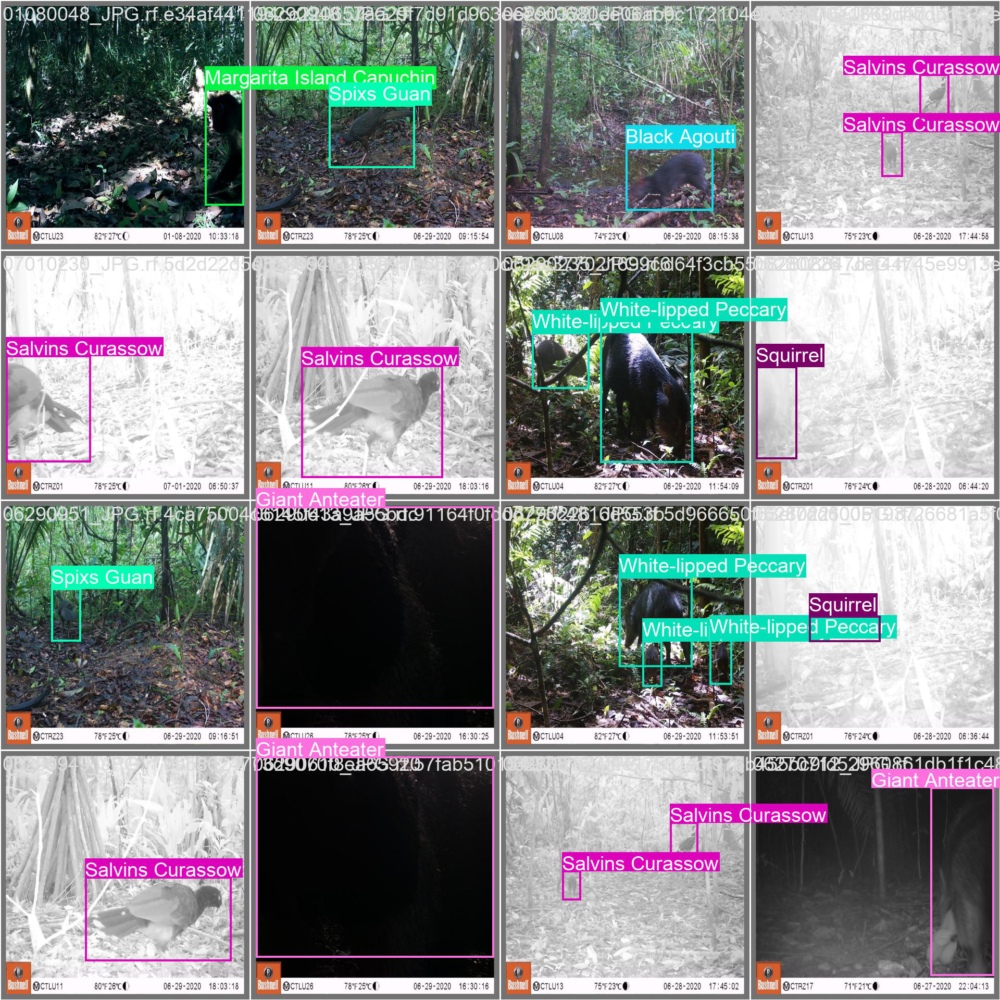

In [168]:
Image.open('runs/detect/train15/val_batch0_labels.jpg')

### 2.4.2 Matriz de confusión

En la lista de archivos descargados, encontramos una matriz de confusión normalizada y otra sin normalizar

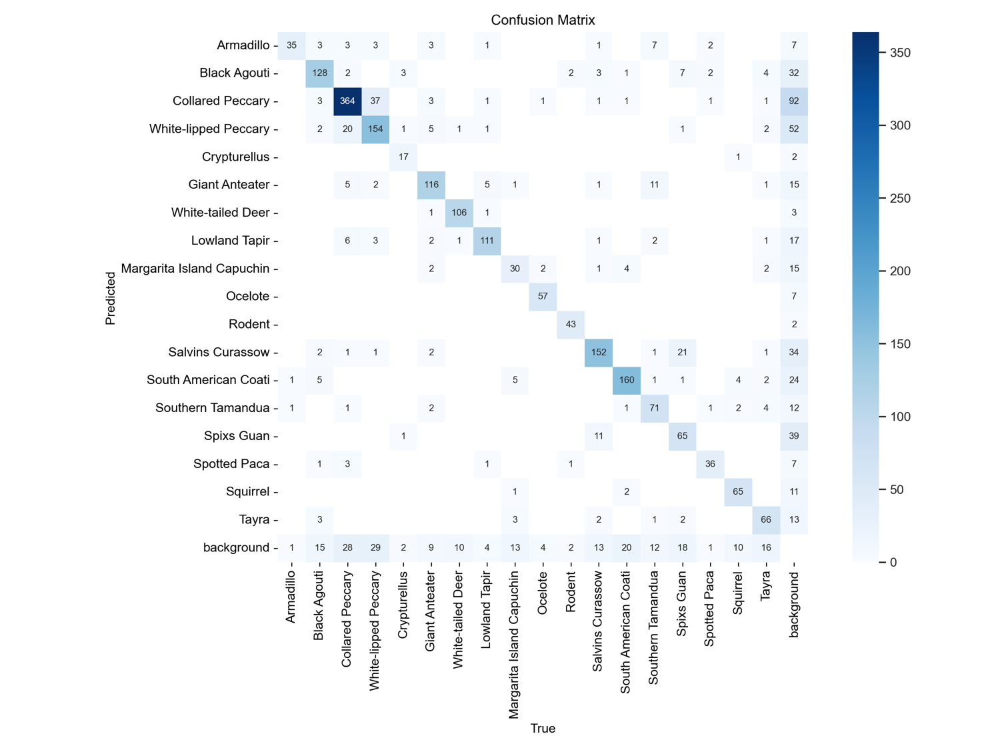

In [170]:
# Show confusion matrix
img_path = 'runs/detect/train15/confusion_matrix.png'
img = Image.open(img_path)
img_resized = img.resize((img.width // 2, img.height // 2))
display.display(img_resized)

Al analizar el desempeño por clase, se destaca que especies como *White-tailed Deer* (P: 0.963, R: 0.919, mAP@50: 0.805) y *Rodent* (P: 0.973, R: 0.875, mAP@50: 0.913) obtuvieron resultados excelentes. Sin embargo, el modelo presentó mayores dificultades con clases menos representadas en el dataset, como *Margarita Island Capuchin* (P: 0.673, R: 0.547, mAP@50: 0.675, mAP@50-95: 0.400) y *Spixs Guan* (P: 0.725, R: 0.583, mAP@50: 0.732, mAP@50-95: 0.482). Estos resultados sugieren la necesidad de ampliar el número de imágenes de estas clases o aplicar técnicas de aumento de datos para mejorar su representación.


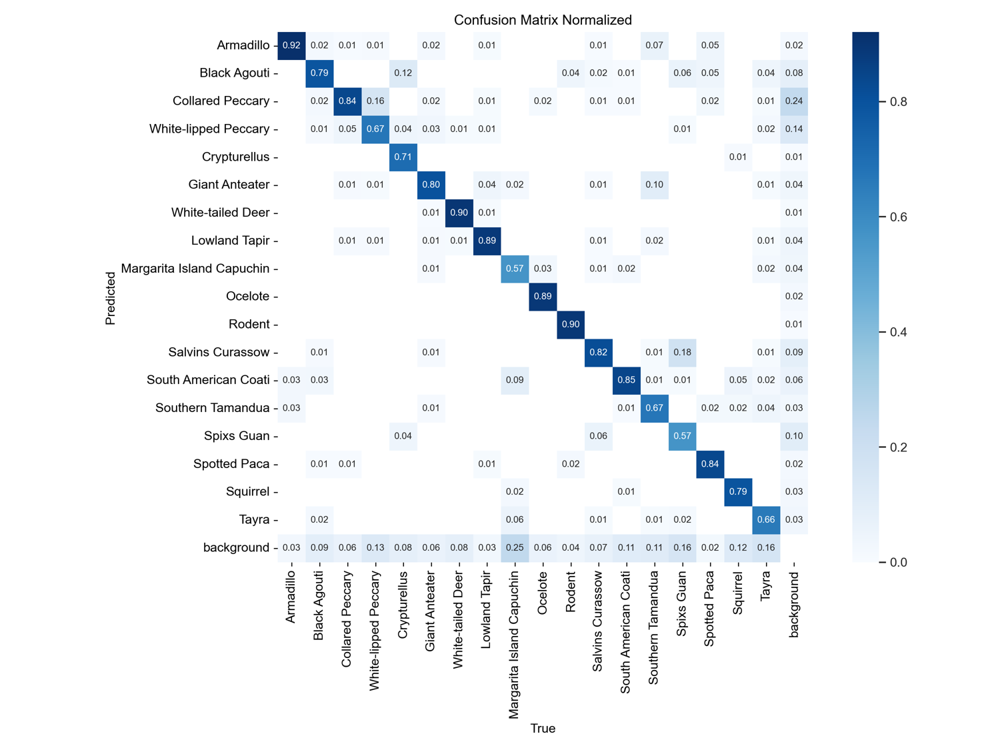

In [172]:
# Show normalized confusion matrix
img_path = 'runs/detect/train15/confusion_matrix_normalized.png'
img = Image.open(img_path)
img_resized = img.resize((img.width // 2, img.height // 2))
display.display(img_resized)

## Insights de la Matriz de Confusión Normalizada

### Desempeño Destacado
- Especies como **White-tailed Deer** (0.90) y **Rodent** (0.90) tienen una alta precisión, lo que indica que el modelo las identifica correctamente en la mayoría de los casos.
- **Ocelote** (0.89) y **Lowland Tapir** (0.89) también muestran un desempeño excelente en la detección.

### Confusiones entre Clases
- Se observan confusiones significativas entre **White-lipped Peccary** y **Collared Peccary**, probablemente debido a similitudes visuales entre estas especies.
- La clase **Margarita Island Capuchin** muestra confusiones con varias otras especies, como **White-tailed Deer** y **South American Coati**, lo que sugiere dificultades del modelo para diferenciarlas.

### Clases con Menor Precisión
- **Spixs Guan** (0.57) y **Margarita Island Capuchin** (0.57) presentan un bajo desempeño, posiblemente debido a un menor número de ejemplos en el dataset o características visuales compartidas con otras clases.
- **Tayra** (0.66) también muestra un desempeño relativamente bajo, sugiriendo que el modelo tiene problemas para reconocerla de manera consistente.

### Rendimiento General
- La diagonal fuerte de la matriz indica que la mayoría de las clases tienen un buen nivel de predicción.
- Las confusiones presentes en clases específicas indican que se podrían implementar estrategias para mejorar la separación entre estas categorías.

### Fondo o "Background"
- El modelo confunde una pequeña proporción de instancias de "fondo" con clases específicas (por ejemplo, **Black Agouti** y **South American Coati**), lo que sugiere similitudes visuales entre estos objetos y el entorno.

### 2.4.3 Metrícas generales

Al encontrarnos en un problema de clasificaciones, YOLO nos calcula los valores para F1 score, recall y precisión para diferentes valores de confianza. Con los cuales podemos graficar las siguientes curvas:

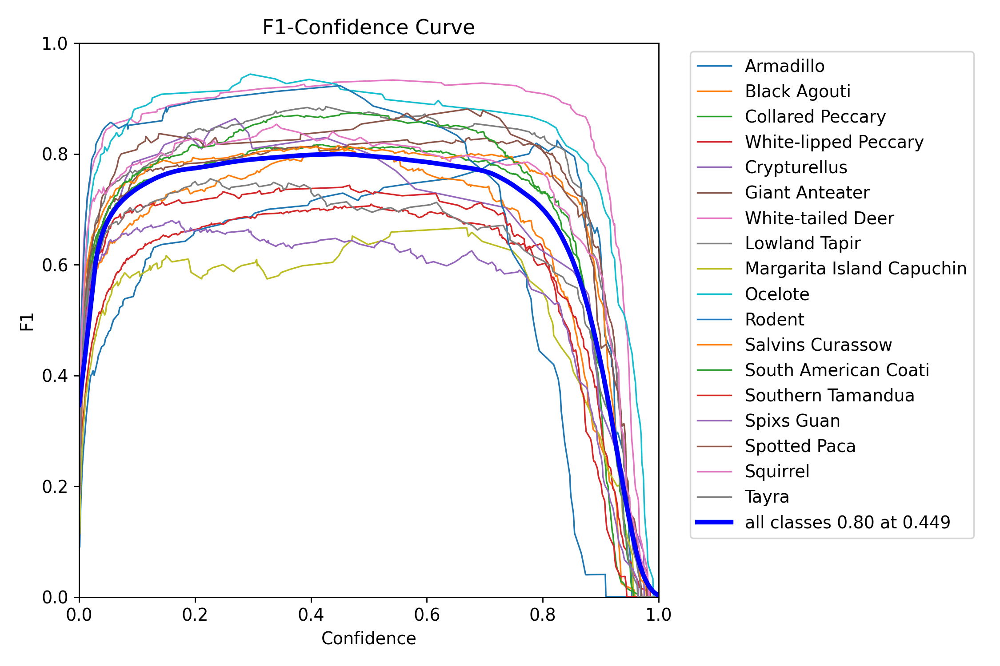

In [174]:
Image.open('runs/detect/train15/F1_curve.png')

## Insights sobre la curva de confianza F1

### Rendimiento General
- La curva promedio (azul gruesa) que representa todas las clases alcanza un puntaje F1 máximo de **0.80** con un valor de confianza de **0.449**. Este punto indica el mejor equilibrio entre precisión y recuperación para el modelo en general.

### Comportamiento Individual de las Clases
- Clases como **White-tailed Deer** y **Rodent** presentan curvas consistentemente altas, lo que demuestra un rendimiento confiable y estable en un rango amplio de valores de confianza.
- Por el contrario, clases como **Margarita Island Capuchin** y **Spixs Guan** tienen curvas más irregulares y valores máximos más bajos, lo que evidencia dificultades del modelo para clasificarlas de manera consistente.

### Diferencias en Estabilidad
- Clases como **Giant Anteater** y **Ocelot** tienen curvas más suaves, lo que sugiere un rendimiento estable sin fluctuaciones significativas al variar el nivel de confianza.
- En contraste, clases como **Southern Tamandua** muestran fluctuaciones pronunciadas, indicando una mayor sensibilidad del modelo al seleccionar umbrales de confianza.

### Interpretación del Umbral de Confianza
- Un valor de confianza óptimo de **0.449** ofrece el mejor equilibrio global entre precisión y recuperación. 
- Valores más bajos pueden aumentar la recuperación pero incrementan los falsos positivos, mientras que valores más altos reducen falsos positivos a costa de disminuir la recuperación.

### Clases con Bajo F1
- Clases como **Margarita Island Capuchin** y **Spixs Guan** presentan valores bajos de F1, probablemente debido a una menor representación en el dataset o características visuales compartidas con otras clases.

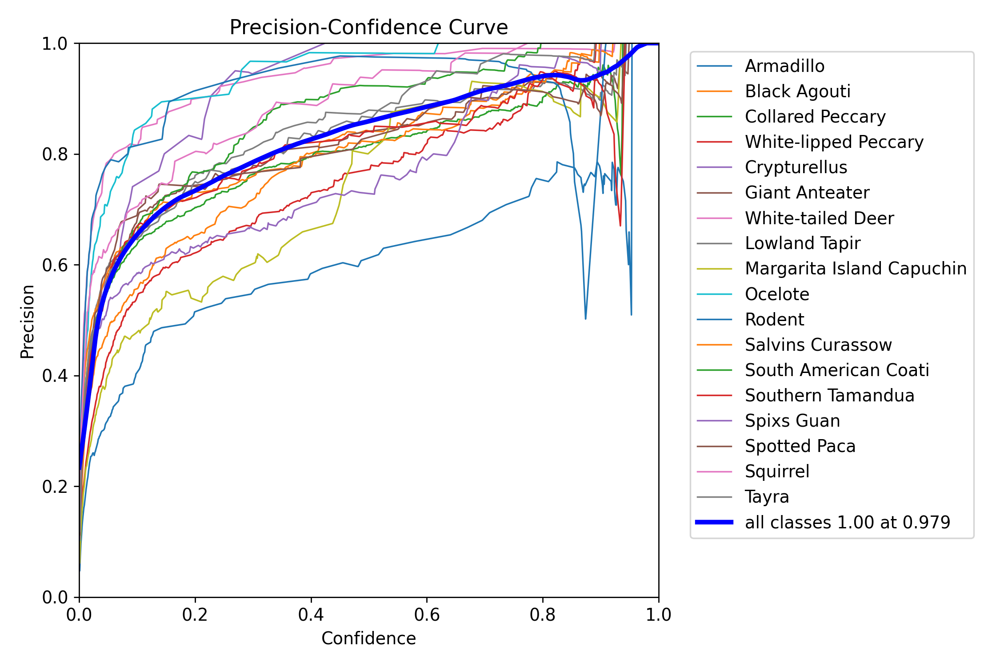

In [176]:
Image.open('runs/detect/train15/P_curve.png')

## Insights sobre la curva de Precisión-Confianza

### Rendimiento General
- La curva promedio (azul gruesa) alcanza una precisión de **1.00** en un nivel de confianza de **0.979**, lo que indica que, a este umbral, las predicciones son altamente precisas pero posiblemente a costa de una menor recuperación.

### Comportamiento Individual de las Clases
- Clases como **White-tailed Deer**, **Rodent** y **Ocelote** muestran un comportamiento consistente, alcanzando altos niveles de precisión incluso en rangos de confianza más bajos, lo que las posiciona como clases fáciles de identificar para el modelo.
- Clases como **Margarita Island Capuchin** y **Spixs Guan** presentan curvas más bajas e irregulares, lo que sugiere problemas de precisión, posiblemente debido a una menor representación en el dataset o características visuales similares con otras clases.

### Diferencias en Estabilidad
- Especies como **Giant Anteater** y **South American Coati** tienen curvas relativamente suaves, indicando que el modelo es consistente al clasificar estas especies en un rango amplio de valores de confianza.
- Clases como **Tayra** muestran variaciones abruptas, lo que refleja una mayor sensibilidad del modelo al seleccionar umbrales de confianza para estas categorías.

### Interpretación del Umbral de Confianza
- A niveles altos de confianza (cercanos a 1.0), el modelo prioriza la precisión a costa de reducir la cantidad de predicciones. Este comportamiento es útil para evitar falsos positivos, pero podría no ser ideal en escenarios donde la recuperación es prioritaria.
- En niveles de confianza más bajos, el modelo realiza más predicciones, pero con un impacto negativo en la precisión para ciertas clases menos representadas.

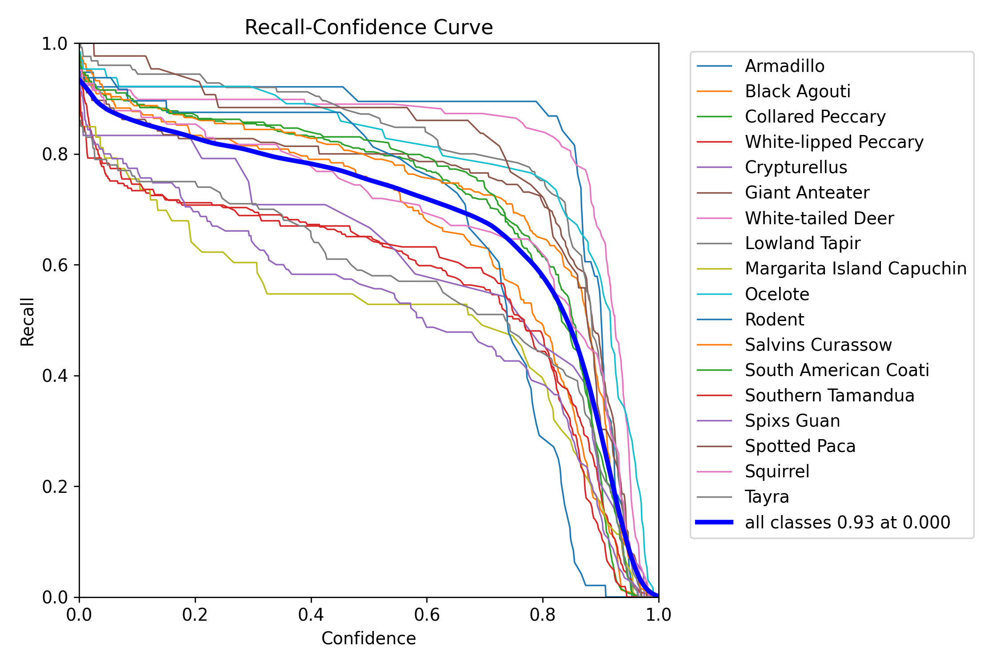

In [178]:
Image.open('runs/detect/train15/R_curve.png')

## Insights sobre la curva Recall-Confidence

### Rendimiento General
- La curva promedio (azul gruesa) alcanza un valor de *recall* máximo de **0.93** con un nivel de confianza cercano a **0.0**, lo que indica que, al aceptar predicciones con baja confianza, se detectan más instancias correctamente, aunque probablemente a costa de una mayor tasa de falsos positivos.

### Comportamiento Individual de las Clases
- Especies como **White-tailed Deer**, **Rodent**, y **Ocelote** mantienen un *recall* elevado en un rango más amplio de niveles de confianza, lo que refleja una alta capacidad del modelo para identificar estas clases correctamente.
- Clases como **Margarita Island Capuchin** y **Spixs Guan** tienen curvas más bajas y descienden rápidamente, indicando dificultades del modelo para identificar estas clases a medida que aumenta el nivel de confianza.

### Diferencias en Estabilidad
- Clases como **Giant Anteater** y **South American Coati** presentan curvas relativamente suaves, lo que implica un comportamiento estable al identificar estas especies en diferentes niveles de confianza.
- En contraste, clases como **Tayra** muestran fluctuaciones significativas y una caída abrupta del *recall* en niveles de confianza más altos, reflejando una mayor sensibilidad del modelo para estas categorías.

### Interpretación del Umbral de Confianza
- En niveles bajos de confianza, el modelo prioriza el *recall*, detectando la mayoría de las instancias correctamente. Sin embargo, esto incrementa la probabilidad de falsos positivos.
- A medida que aumenta la confianza, el *recall* disminuye significativamente para algunas clases, especialmente las menos representadas, como **Margarita Island Capuchin** y **Spixs Guan**.

## 2.5 Resultados del modelo en Val

Como se mencionó anteriormente, el entrenamiento de la red es bastante exigente, por lo cual se cargaran los pesos del modelo previamente entrenado, los cuales fueron descargados y cargados en pasos anteriores.

Ahora simplemente podemos llamar la función 'val' de nuestro modelo para generar los resultados en el conjunto de Validación

In [180]:
results = model.val(data=YAML_PATH, imgsz=IMAGE_SIZE, name="val")

Ultralytics YOLOv8.2.98  Python-3.12.7 torch-2.5.1+cpu CPU (Intel Xeon Silver 4310 2.10GHz)
Model summary (fused): 168 layers, 3,009,158 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\proyecto\Documents\Proyecto\MINE-4210_202420_ADL\Proyecto_Ajustado\images\valid\labels.cache... 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 118/118 [01:


                   all       1881       2260      0.837      0.775      0.836      0.565
             Armadillo         38         38      0.597      0.921      0.729      0.532
          Black Agouti        156        162      0.825      0.788      0.849      0.579
      Collared Peccary        258        433      0.804      0.823      0.844      0.603
  White-lipped Peccary        126        229      0.739      0.664      0.739      0.527
          Crypturellus         21         24          1      0.704      0.838      0.506
        Giant Anteater        145        145      0.814        0.8      0.852      0.692
     White-tailed Deer        117        118      0.963       0.89      0.919      0.805
         Lowland Tapir        124        125      0.875      0.893      0.905      0.706
Margarita Island Capuchin         51         53      0.673      0.547      0.675        0.4
               Ocelote         62         64      0.983      0.879      0.952      0.625
                Ro

Podemos observar que se generó una carpeta llamada 'val' en nuestra carpeta de **runs/detect**, la cual cuenta con los mismos archivos que la carpeta analizada anteriormente, como por ejemplo la matriz de confusión:

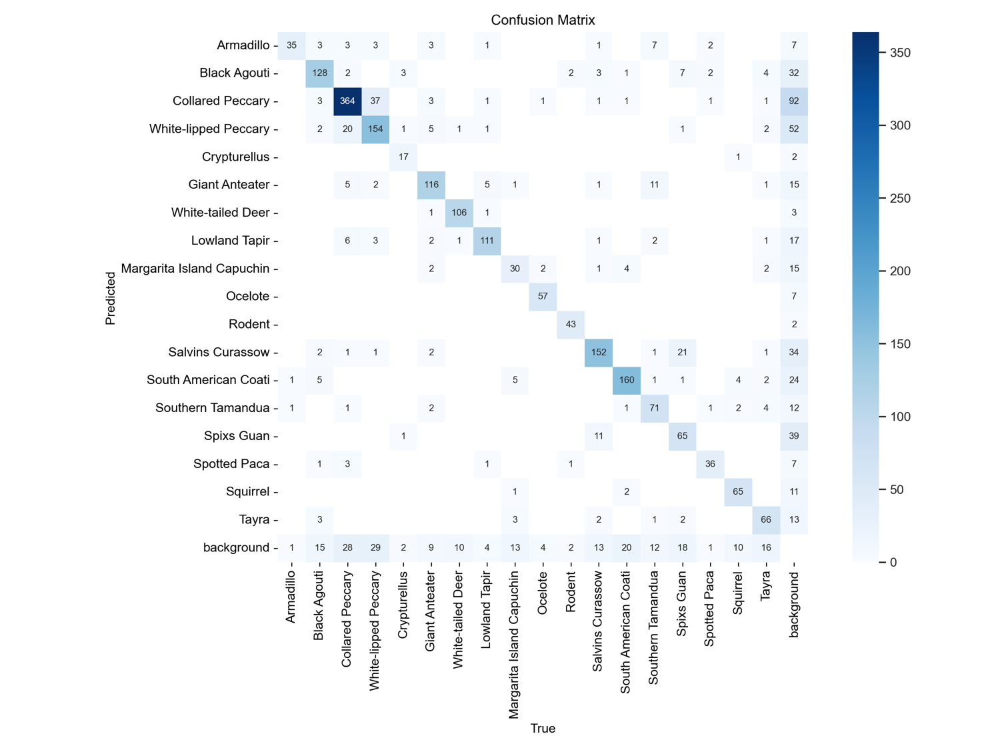

In [183]:
# Show confusion matrix
img_path = 'runs/detect/val/confusion_matrix.png'
img = Image.open(img_path)
img_resized = img.resize((img.width // 2, img.height // 2))
display.display(img_resized)

# 3. Predicciones del modelo base en Test

## 3.1 Prediciendo labels

Vamos a proceder a realizar las predicciones en el conjunto de datos Test, recordemos que estos son datos nuevos para el modelo

In [187]:
# Realizar la predicción en la carpeta "test"
results = model.predict(source=images_test_path, conf=conf_threshold, save=True, imgsz=IMAGE_SIZE, name="predict")



WARNING  inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

image 1/2050 C:\Users\proyecto\Documents\Proyecto\MINE-4210_202420_ADL\Proyecto_Ajustado\images\test\images\01080050_JPG.rf.a39e1def23b117b531f7bf50dcb382aa.jpg: 640x640 1 Margarita Island Capuchin, 73.4ms
image 2/2050 C:\Users\proyecto\Documents\Proyecto\MINE-4210_202420_ADL\Proyecto_Ajustado\images\test\images\01090058_JPG.rf.9a4c32e749448fb98dd19bb0eebba197.jpg: 640x640 1 Black Agouti, 52.4ms
image 3/2050 C:\Users\proyecto\Documents\Proyecto\MINE-4210

Nuevamente podemos observar que se generó una nueva carpeta *runs/detect/predict/*, sin embargo ahora está compuesta por el resultado de todas las predicciones

## 3.2 Mostrando algunos resultados

Para corroborar que las imagenes generadas, presenten las etiquetas, procedemos a mostrar algunas de estas:

In [193]:
def get_all_images(dir):
  return [os.path.join(dir, img) for img in os.listdir(dir)]

# Getting images
train_images = get_all_images(images_train_path)
val_images = get_all_images(images_val_path)
test_images = get_all_images(images_test_path)

In [195]:
# Predict images folder
predict_images_path = 'runs/detect/predict'

# Predict images
predict_images = get_all_images(predict_images_path)

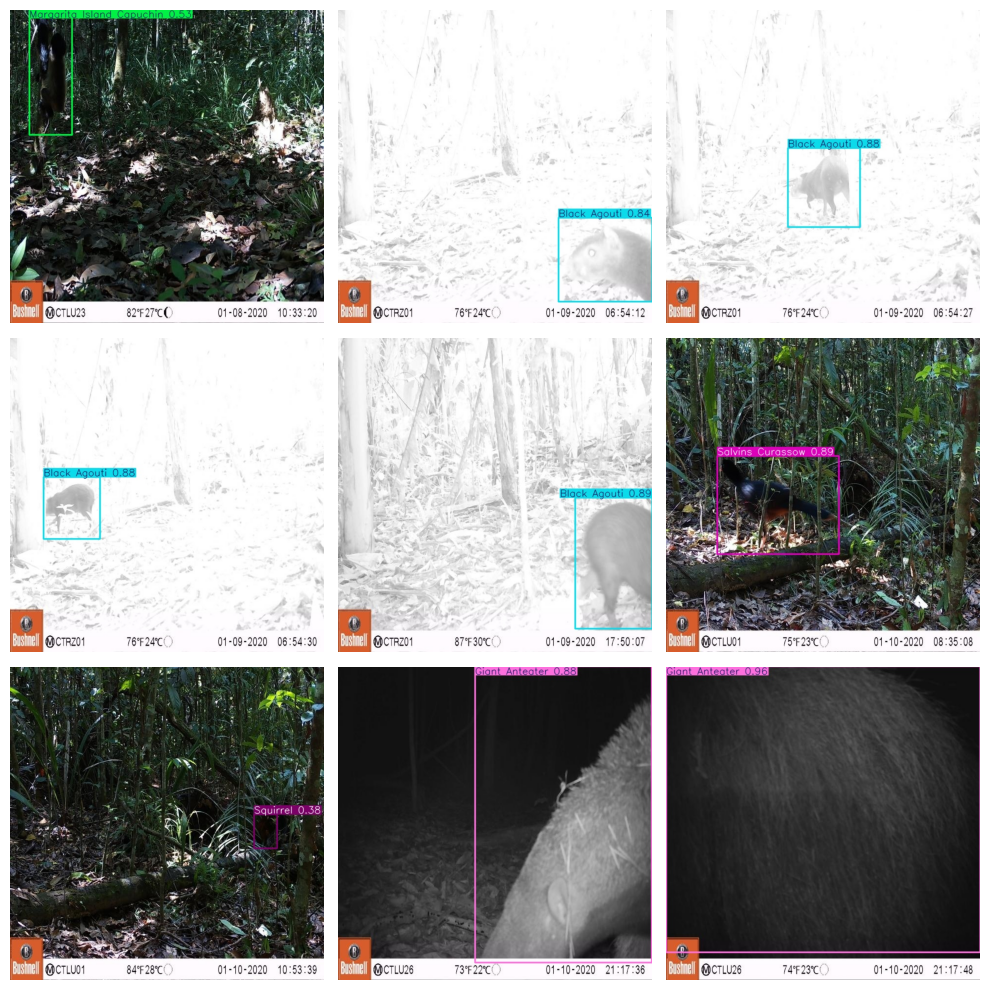

In [197]:
# Show selected images
show_image_grid(predict_images[:9])

Podemos corroborar que las etiquetas fueron predichas y dibujadas en las imagenes exitosamente.

# 6. Métricas por Clase

Como se mencionó anteriormente, YOLO nos generá un archivo llamado **results.csv**. El cuál contiene algunas metricas interesantes para cada una de las clases. Sin embargo escogimos **mAP** para poder realizar la comparación entre los diferentes modelos en la busqueda de hiperparametros y encontrar el *mejor modelo*. En esta sección explicaremos qué es **mAP** y hablaremos de su importancia.


## 6.1 Información guardada

Una de las secciones del resultado es la descomposición de las métricas de rendimiento por clase. Esta información detallada es útil cuando se busca entender qué tan bien está funcionando el modelo para cada clase específica, especialmente en conjuntos de datos con una amplia variedad de categorías de objetos. Para cada clase en el conjunto de datos, se proporciona la siguiente información:

- **Clase (Class)**: Indica el nombre de la clase del objeto, como "persona", "coche" o "perro".

- **Imágenes (Images)**: Esta métrica muestra la cantidad de imágenes en el conjunto de validación que contienen la clase de objeto.

- **Instancias (Instances)**: Proporciona el número de veces que la clase aparece en todas las imágenes del conjunto de validación.

- **Box (P, R, mAP50, mAP50-95)**: Esta métrica ofrece una visión del rendimiento del modelo en la detección de objetos:

  - **P (Precisión)**: La precisión de los objetos detectados, indicando cuántas detecciones fueron correctas.

  - **R (Recall)**: La capacidad del modelo para identificar todas las instancias de objetos en las imágenes.

  - **mAP50**: La precisión media calculada en un umbral de *Intersection over Union* (IoU) de 0.50. Es una medida de la precisión del modelo considerando únicamente las detecciones "fáciles".

  - **mAP50-95**: El promedio de la precisión media calculada en varios umbrales de IoU, que varían de 0.50 a 0.95. Proporciona una visión integral del rendimiento del modelo en diferentes niveles de dificultad de detección.

## 6.2 Métrica Mean Average Precision (mAP)

El **mAP (Mean Average Precision)** es una métrica utilizada en tareas de detección de objetos y segmentación, así como en problemas de clasificación multiclase. Aquí te doy una descripción más detallada de cómo se calcula, sus variantes y su utilidad:

### 6.2.1 Definición y Cálculo
El mAP mide la capacidad del modelo para predecir correctamente la clase y la localización de objetos dentro de una imagen. Se calcula promediando la precisión promedio (AP) de cada clase. La precisión promedio para cada clase se obtiene calculando el área bajo la curva de precisión-recall.

- **AP (Average Precision)**: Es el área bajo la curva de precisión-recall. Se calcula para cada clase y se define como la media ponderada de las precisiones alcanzadas en cada umbral de *recall*, donde el peso es el incremento de *recall* desde el umbral anterior.

- **mAP0.5**: Es el valor de mAP calculado a un único umbral de *Intersection over Union* (IoU), por ejemplo, 0.50. Un IoU de 0.50 significa que un objeto detectado se considera correcto si la intersección entre la caja predicha y la caja real es al menos el 50% del área total.

- **mAP0.50:0.95**: Es un promedio de mAP calculado en un rango de umbrales de IoU (0.50 a 0.95 en incrementos de 0.05). Esto proporciona una visión más completa del rendimiento del modelo, evaluando su capacidad para detectar objetos en diferentes niveles de superposición entre las cajas predichas y las reales.


### 6.2.2 Interpretación de mAP
El valor de mAP proporciona información sobre el balance entre precisión y recall. Un mAP bajo puede significar que el modelo tiene muchas predicciones incorrectas (baja precisión) o que no está detectando todas las instancias de los objetos presentes (bajo recall). La interpretación se puede hacer a nivel global (promedio de todas las clases) o a nivel de cada clase (mAP por clase).

### 6.2.3 Uso del mAP en Detección de Objetos
El mAP es una métrica estándar en tareas de detección de objetos. La mayoría de los desafíos de visión por computadora, como COCO y PASCAL VOC, utilizan el mAP para evaluar el rendimiento de los modelos. El mAP0.50 se usaba comúnmente en el pasado, pero el mAP0.50:0.95 se ha convertido en el estándar porque evalúa el modelo en una variedad de umbrales de dificultad.


### 6.2.4 Consideraciones en el Cálculo de mAP
El mAP considera diferentes niveles de umbrales de confianza, lo cual es importante para ajustar el modelo en función de los requerimientos específicos del problema. Por ejemplo, si se quiere minimizar los falsos positivos, se puede incrementar el umbral de confianza, lo que mejorará la precisión a expensas del recall.

### 6.2.5 Ventajas y Limitaciones del mAP
- **Ventajas**:
  - Proporciona una evaluación detallada del modelo considerando tanto la localización como la clasificación de objetos.
  - Permite evaluar el rendimiento en múltiples clases.
  - Evalúa el rendimiento del modelo en diferentes umbrales de IoU, ofreciendo una perspectiva más integral del comportamiento del modelo.

- **Limitaciones**:
  - El cálculo de mAP puede ser computacionalmente costoso, especialmente cuando se evalúa en múltiples umbrales de IoU.
  - No siempre refleja correctamente la calidad de las predicciones si la métrica se calcula usando pocos datos o con clases desbalanceadas.

En resumen, el mAP es una métrica poderosa para evaluar modelos de detección de objetos, pero debe ser interpretada con cuidado dependiendo del contexto y de los datos utilizados en la evaluación.


## 7.2 Análisis de Resultados

### 7.2.1 Precisión (P)
- **Definición**: Mide cuántos de los objetos detectados son correctos.
- **Observación**: La curva de Precisión-Confianza muestra que el modelo alcanza una precisión promedio de **1.00** a un nivel de confianza alto (0.979). Sin embargo, clases como *Margarita Island Capuchin* y *Spixs Guan* presentan precisión más baja, lo que sugiere desafíos en la identificación correcta de estas especies.
- **Conclusión**: Aunque el modelo logra una alta precisión en general, se debe trabajar en mejorar las predicciones para clases menos representadas, donde la precisión aún no es óptima.

### 7.2.2 Recall (R)
- **Definición**: Indica cuántos de los objetos presentes en realidad fueron detectados.
- **Observación**: El valor de *recall* promedio es **0.93** en niveles de confianza bajos, pero disminuye drásticamente en niveles altos para clases como *Tayra* y *Margarita Island Capuchin*. Este comportamiento refleja la dificultad del modelo para detectar estas especies bajo condiciones más estrictas.
- **Conclusión**: Si bien el modelo logra detectar correctamente una gran proporción de objetos en confianza baja, el desafío radica en mantener este rendimiento a niveles más altos de confianza.

### 7.2.3 mAP@0.5 (mAP50)
- **Definición**: Evalúa la precisión media con un umbral de IoU del 50%.
- **Observación**: El mAP@50 muestra un buen desempeño en clases como *White-tailed Deer* y *Rodent*, con valores consistentes en rangos amplios de confianza. Sin embargo, clases como *Spixs Guan* muestran un desempeño significativamente menor.
- **Conclusión**: El modelo es efectivo en detectar las clases más representadas, pero el bajo mAP de ciertas clases menos frecuentes sugiere la necesidad de mejorar el balance del dataset o ajustar el modelo.

### 7.2.4 mAP@0.5-0.95 (mAP50-95)
- **Definición**: Promedia la precisión media para umbrales de IoU de 0.5 a 0.95, reflejando la calidad en un rango más amplio.
- **Observación**: El mAP@50-95 es más bajo que el mAP@50, reflejando una disminución de la calidad en predicciones más complejas. Clases como *Tayra* y *Margarita Island Capuchin* contribuyen significativamente a esta disminución.
- **Conclusión**: El modelo muestra limitaciones en la detección de clases menos representadas a lo largo de un rango más amplio de IoU, lo que resalta la necesidad de estrategias de mejora en la representación de estas clases.



# 9. Conclusiones Finales.

## 8.5 Eficacia de YOLO para la Detección de Objetos en Cámaras Trampa

El uso de **YOLO (You Only Look Once)** es altamente eficaz para la detección de fauna en escenarios naturales, permitiendo identificar múltiples especies en una sola operación. Su capacidad para manejar objetos de diferentes escalas y en posiciones superpuestas lo hace ideal en el contexto de cámaras trampa, donde las especies animales a menudo se encuentran en entornos visualmente complejos y con variaciones de iluminación. Esta rapidez y precisión en la detección simultánea de múltiples especies lo convierte en una herramienta clave para el monitoreo de biodiversidad y la investigación en conservación de fauna.

## 8.6 Tiempo de Entrenamiento

El ajuste del modelo YOLO ha implicado un análisis detallado de los tiempos de entrenamiento. En el **modelo base**, el entrenamiento tomó aproximadamente **3 horas**, un tiempo razonable considerando el tamaño del dataset y la complejidad de la tarea. Sin embargo, tras ajustar los hiperparámetros, el tiempo de entrenamiento del **modelo ajustado** se incrementó a **5 horas**. Este incremento se debe a mejoras específicas en la arquitectura, como el ajuste del **Backbone**, la adición de filtros y el aumento del número de épocas.

A pesar del aumento en el tiempo, los resultados obtenidos justifican la inversión computacional. La mejora en métricas como la **precisión global (P)** y el rendimiento en clases clave, como *White-tailed Deer* y *Rodent*, demuestra la efectividad del modelo ajustado, especialmente en el manejo de superposición de especies y condiciones de iluminación variables.

## 8.7 Próximos Pasos

En conclusión, el desarrollo y evaluación de nuestro modelo de detección de objetos en cámaras trampa han revelado importantes avances y áreas de mejora. A lo largo del proceso, hemos optimizado la arquitectura mediante un **Backbone** adicional y ajustes en el **Neck**, lo que ha permitido mejorar la identificación de especies en situaciones de superposición y complejidad visual.

A pesar de los logros, como un mAP de **0.7067**, aún enfrentamos desafíos en el reconocimiento de especies menos representadas y con características visuales similares. El modelo ha mostrado un rendimiento notable en la detección de especies con mayor representación en el dataset, pero se requieren esfuerzos adicionales para mejorar la identificación en clases como *Spixs Guan* y *Margarita Island Capuchin*.

Para los próximos pasos:
1. **Aumento de Datos:** Incrementar la cantidad de imágenes para clases menos representadas, aplicando técnicas de aumentación de datos para mejorar la diversidad visual.
2. **Ajustes Adicionales:** Explorar nuevas configuraciones de hiperparámetros, como ajustes en la tasa de aprendizaje y número de épocas, para refinar aún más el rendimiento.
3. **Comparativa con Otros Modelos:** Evaluar el desempeño del modelo frente a otras arquitecturas para identificar oportunidades de mejora en escenarios complejos.
4. **Balance entre Tiempo y Precisión:** Continuar analizando la relación entre el tiempo de entrenamiento y las mejoras en precisión, especialmente en entornos donde el tiempo es un factor crítico.

Este enfoque garantizará que el modelo no solo cumpla con los estándares necesarios para aplicaciones en monitoreo de biodiversidad, sino que también pueda ser replicado en otros proyectos de conservación de fauna en entornos naturales.
